# Changelog:

* 2.0d (2019.04.17-2019.05.06)
 - Adding dask support
 - Many code refactorings for semiautomatic runs
 - Allow manual borders selections
* 2.0.b1 (2019.04.03)
 - bug fixing
 - try remove bad frames
* 1.6.2 (2019.02.11)
 - fixing object detection
* 1.6.1 (2018.11.19)
 - exdend borbers range (mean to percentile) 
* 1.6 (2018.11.08)
 - change algorithm of object detection with gaussian fitting
 - add y-clipping to remove sample holder
 - change algorithm of axis searching
 - change hdf5 compression to lzf
 - changing 3d visualisation
 - replace log_process to tqdm
* 1.5 (2018.09.11)
 - saving full tomography volume
 - deleting temporary files as soon as possible
 - change thresshold in object detection (1/6 -> 1/5) 
* 1.4 (2018.08.23)
 - Fix: correct resized volume serialization (smooth instead cherry picking)
 - New: 3D visualisation
 - Fix: sinogram shifting aftee rotation axis fix
 - Update: Searching rotation axis
* 1.3 (2018.07.03)
 - Update graphics
 - Update axis search algorithms
* 1.2 (2018.06.04)
 - Change threshold
* 1.1 (2018.03.14) 
 - Add NLM filtering
* 1.0 (2017.02.01) 
 - First automation version.

In [1]:
%matplotlib notebook
# import matplotlib
# matplotlib.rcParams.update({'font.size': 16})

In [37]:
import logging
logger = logging.getLogger()
logger.setLevel(logging.INFO)
import os
import h5py

import pylab as plt
import numpy as np
import dask.array as da

import numexpr as ne
import cv2
import time
import astra
import tomopy
import requests, json
import configparser
from skimage.restoration import denoise_nl_means, estimate_sigma
from skimage.measure import compare_psnr
from skimage.transform import resize
import scipy.optimize
import scipy.signal

from tqdm import tqdm_notebook
from ipywidgets import interact, widgets

from glob import glob
import tomotools2 as tomotools

In [3]:
# # settings for docker

config = configparser.ConfigParser()
config.read('tomo.ini')
experiment_id = config['SAMPLE']['_id']
data_dir = '/fast/'
storage_dir = '/storage/'
STORAGE_SERVER = "http://rbtmstorage_server_1:5006/"

In [158]:
# STORAGE_SERVER = 'http://10.0.7.153:5006/'
# storage_dir = '/diskmnt/a/makov/robotom/'
# experiment_id = '907e8b4b-541e-49a1-835e-3a88863437f2'
# data_dir = '/diskmnt/fast/makov/robotom/'

In [170]:
tomo_info = tomotools.get_tomoobject_info(experiment_id, STORAGE_SERVER)
tomo_info

{'_id': '907e8b4b-541e-49a1-835e-3a88863437f2',
 'experiment parameters': {'DARK': {'count': 10, 'exposure': 5000.0},
  'DATA': {'angle step': 0.5,
   'count per step': 1,
   'step count': 400,
   'exposure': 5000.0},
  'EMPTY': {'count': 10, 'exposure': 5000.0},
  'advanced': False},
 'tags': 'cu, mono, pericard',
 'timestamp': 1556174916.14069,
 'specimen': 'pericard_intact_12w_apr2019',
 'datetime': '25.04.2019 09:48:36',
 'finished': True}

In [5]:
def load_tomo_data(data_file, tmp_dir):
    empty_images, _ = tomotools.get_frame_group(data_file, 'empty', tmp_dir)
    dark_images, _ = tomotools.get_frame_group(data_file, 'dark', tmp_dir)

    empty_image = np.median(empty_images,axis=0) 
    dark_image = np.median(dark_images,axis=0)

    empty_beam = empty_image - dark_image
    
    # Загружаем кадры с даннымии
    #TODO: добавить поддержку, когда много кадров на одном угле
    data_images, data_angles = tomotools.get_frame_group(data_file, 'data', tmp_dir)
    
    data_images_clear = da.from_array(data_images, chunks=(1, 1024,1024))-dark_image
    return empty_beam, data_images_clear, data_angles

# Loading experimental data

In [6]:
data_file = tomotools.get_experiment_hdf5(experiment_id, data_dir, STORAGE_SERVER)

tmp_dir = os.path.join(data_dir, experiment_id)
tomotools.mkdir_p(tmp_dir)

empty_beam, data_images, data_angles = load_tomo_data(data_file, tmp_dir)

INFO:root:Output experiment HDF5 file: /diskmnt/fast/makov/robotom/907e8b4b-541e-49a1-835e-3a88863437f2.h5
INFO:root:File exests. Use local copy


INFO:root:Loading existing file: /diskmnt/fast/makov/robotom/907e8b4b-541e-49a1-835e-3a88863437f2/group_empty.tmp
INFO:root:Loading existing file: /diskmnt/fast/makov/robotom/907e8b4b-541e-49a1-835e-3a88863437f2/group_empty_angles.tmp
INFO:root:Images and angles in group empty found. Skip it


INFO:root:Loading existing file: /diskmnt/fast/makov/robotom/907e8b4b-541e-49a1-835e-3a88863437f2/group_dark.tmp
INFO:root:Loading existing file: /diskmnt/fast/makov/robotom/907e8b4b-541e-49a1-835e-3a88863437f2/group_dark_angles.tmp
INFO:root:Images and angles in group dark found. Skip it


INFO:root:Loading existing file: /diskmnt/fast/makov/robotom/907e8b4b-541e-49a1-835e-3a88863437f2/group_data.tmp
INFO:root:Loading existing file: /diskmnt/fast/makov/robotom/907e8b4b-541e-49a1-835e-3a88863437f2/group_data_angles.tmp
INFO:root:Images and angles in group data found. Skip it


In [15]:
def show_exp_data(empty_beam, data_images):
    max_intensity = np.percentile(empty_beam[:],90)
    plt.figure(figsize=(8,12))
    plt.subplot(211)
    plt.imshow(empty_beam.T, vmin=0, vmax=max_intensity, cmap=plt.cm.gray, interpolation='bilinear')
    cbar = plt.colorbar()
    cbar.set_label('Интенсивность, усл.ед.', rotation=90)
    plt.title('Прямой пучок')
    plt.xlabel('Номер канала детектора')
    plt.ylabel('Номер канала детектора')

    plt.subplot(212)
    plt.imshow(data_images[0].T, vmin=0, vmax=max_intensity, cmap=plt.cm.gray, interpolation='bilinear')
    cbar = plt.colorbar()
    cbar.set_label('Интенсивность, усл.ед.', rotation=90)
    plt.title('Изображение объекта')
    plt.xlabel('Номер канала детектора')
    plt.ylabel('Номер канала детектора')
    plt.show()

<IPython.core.display.Javascript object>


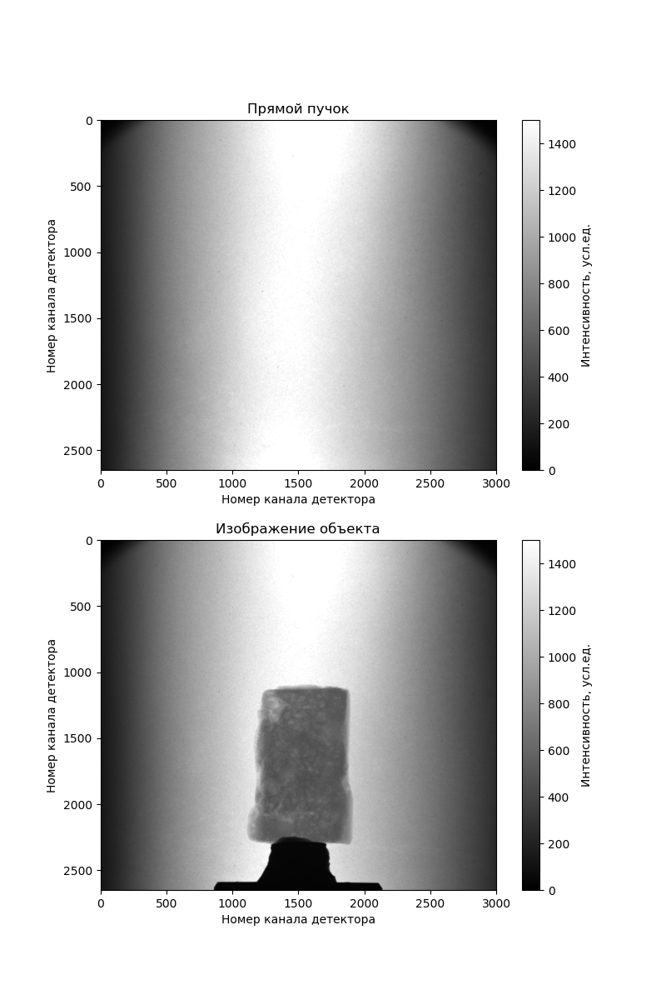

In [17]:
show_exp_data(empty_beam, data_images)

<IPython.core.display.Javascript object>


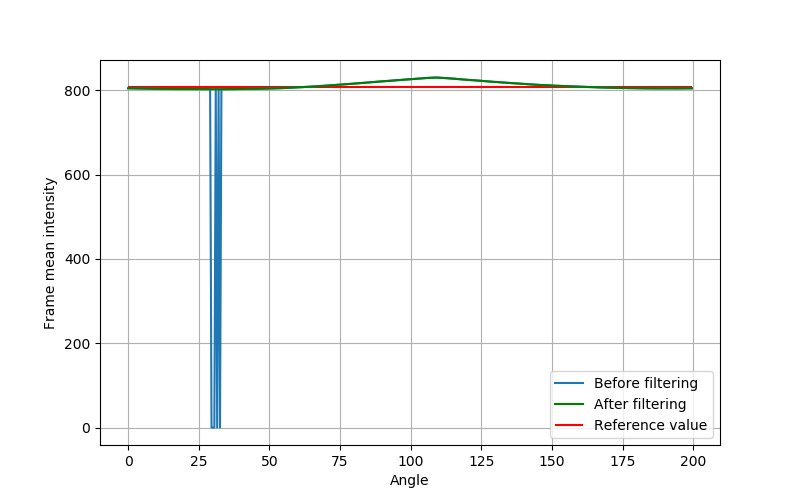

In [22]:
def find_good_frames(data_images, data_angles):
    intensity = data_images.mean(axis=-1).mean(axis=-1)

    intensity_mask = (intensity<1.2*intensity.mean()) * (intensity>0.8*intensity.mean())  # dorp bad points
    good_frames = np.arange(len(intensity))[intensity_mask]

    intensity_t = intensity[good_frames]
    data_angles_t = data_angles[good_frames]
    
    plt.figure(figsize=(8,5))
    plt.plot(data_angles[np.argsort(data_angles)],
             intensity[np.argsort(data_angles)], 
             label='Before filtering')
    
    plt.hlines(np.median(intensity),0, np.max(data_angles),'r', label='Reference value')
    
    plt.plot(data_angles_t[np.argsort(data_angles_t)], 
             intensity_t[np.argsort(data_angles_t)],
             'g', label='After filtering')
    
    plt.xlabel('Angle')
    plt.ylabel('Frame mean intensity')
    plt.grid()
    plt.legend(loc=0)
    plt.show()
    return good_frames

good_frames  = find_good_frames(data_images, data_angles)

# Remove bad frames

In [25]:
data_images_good, _  = tomotools.load_create_mm(os.path.join(tmp_dir,'data_images_good.tmp'),
                        shape=(len(good_frames),
                                   data_images.shape[1],
                                   data_images.shape[2]),
                               dtype='float32')

for i in tqdm_notebook(range(len(good_frames))): 
    data_images_good[i] = data_images[good_frames[i]]
    
data_angles = data_angles[good_frames]

INFO:root:Creating new file: /diskmnt/fast/makov/robotom/907e8b4b-541e-49a1-835e-3a88863437f2/data_images_good.tmp


# Searching object borders

In [ ]:
data_mean = np.mean(data_images_good,axis=0)
data_mean = cv2.medianBlur(data_mean,3)
data_mean[data_mean<=1] = 1

<IPython.core.display.Javascript object>


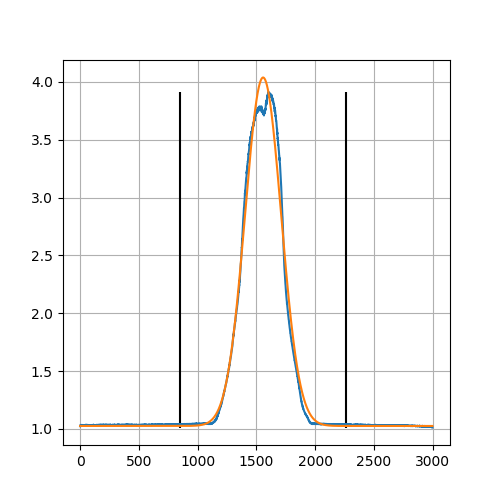

In [42]:
def gauss(x, *p):
    A, mu, sigma, C = p
    return C+A*np.exp(-(x-mu)**2/(2.*sigma**2))

def get_gauss_fit(thr):
    k  = np.percentile(empty_beam/data_mean, thr,axis=-1)
    p0 = [1., len(k)/2., len(k)/4., 0.]

    coeff, var_matrix = scipy.optimize.curve_fit(gauss, range(len(k)), k, p0=p0)

    A, mu, sigma, C = coeff
    sigma = np.abs(sigma)
    return A, mu, sigma, C, k

def get_x_limits():
    A, mu, sigma, C, k = get_gauss_fit(80)

    # res = [get_gauss_fit(k) for k in range(0,100,10)]
    x_min = np.max([200, mu-2*sigma-400]).astype('int32')
    x_max = np.min([len(k)-200, mu+2*sigma+400]).astype('int32')

    plt.figure(figsize=(5,5))
    plt.plot(k)
    plt.plot(gauss(range(len(k)), A, mu, sigma, C))
    plt.vlines([x_min, x_max], k.min(),k.max())
    plt.grid()
    return x_min, x_max

x_min, x_max = get_x_limits()


<IPython.core.display.Javascript object>


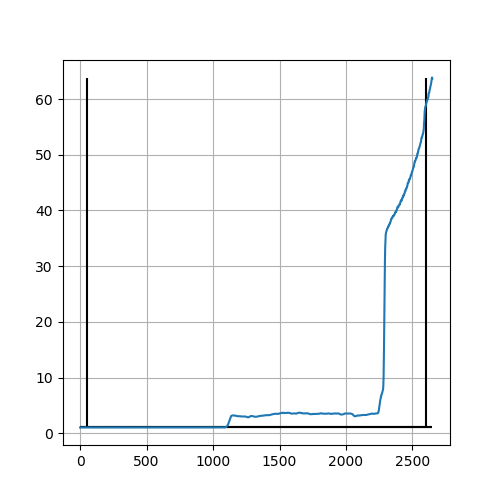

In [44]:
def get_y_limits():
    k  = np.percentile((empty_beam/data_mean)[x_min:x_max,:],90,axis=0)

    k = scipy.signal.medfilt(k,5)

    thr_max  = np.percentile(k,10)
    thr_min  = np.percentile(k,10)
    y_max = np.max(np.argwhere(k>thr_max))- 50
    y_min = np.min(np.argwhere(k>thr_min))+ 50
    y_min = np.max([0, y_min])
    y_max = np.min([len(k), y_max])

    plt.figure(figsize=(5,5))
    plt.plot(k)
    plt.hlines([thr_min, thr_max], 0, len(k))
    plt.vlines([y_min, y_max], min(k), max(k))
    plt.grid()
    
    return y_min,y_max

y_min,y_max = get_y_limits() 


<IPython.core.display.Javascript object>


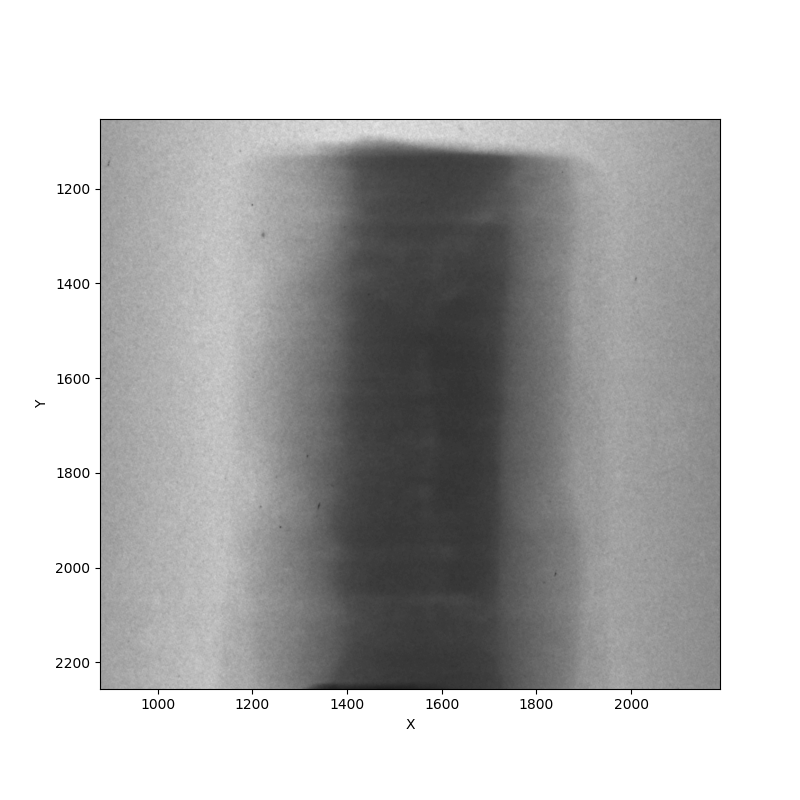

In [89]:
plt.gray()
plt.figure(figsize=(8,8))
ax  = plt.imshow(data_mean.T, vmin=0, interpolation='bilinear')
plt.hlines([y_min,y_max],x_min, x_max,'r')
plt.vlines([x_min,x_max],y_min, y_max,'g')
plt.xlabel('X')
plt.ylabel('Y')
plt.show()

In [90]:
xmin, xmax = np.sort(ax.axes.get_xlim())
ymin, ymax = np.sort(ax.axes.get_ylim())

xmin = np.max([0, int(np.floor(xmin))])
xmax = int(np.ceil(xmax))
ymin = np.max([0, int(np.floor(ymin))])
ymax = int(np.ceil(ymax))
              
xmin = x_min if xmin == 0 else xmin
xmax = x_max if xmax == data_mean.shape[0] else xmax
ymin = y_min if ymin==0 else ymin
ymax = y_max if ymax == data_mean.shape[1] else ymax

INFO:root:Force create
INFO:root:Creating new file: /diskmnt/fast/makov/robotom/907e8b4b-541e-49a1-835e-3a88863437f2/data_images_masked.tmp
INFO:root:Force create
INFO:root:Creating new file: /diskmnt/fast/makov/robotom/907e8b4b-541e-49a1-835e-3a88863437f2/empty_images_masked.tmp


<IPython.core.display.Javascript object>


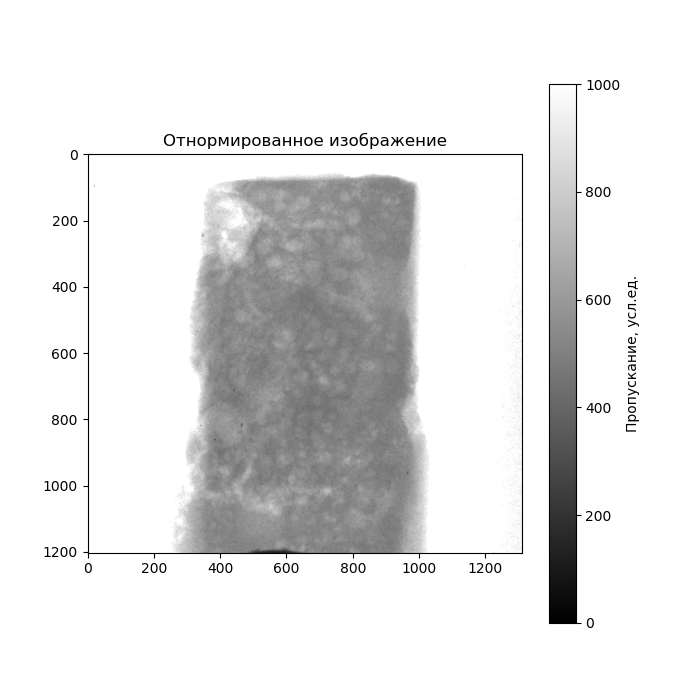

In [91]:
def cut_data_images(data_images, empty_beam, data_angles, xmin, xmax, ymin, ymax):
    data_images_masked, _ = tomotools.load_create_mm(os.path.join(tmp_dir,'data_images_masked.tmp'),
                                       shape = (data_angles.shape[0],
                                                xmax-xmin,
                                                ymax-ymin), dtype='float32',
                                       force_create=True)

    empty_masked, _ = tomotools.load_create_mm(os.path.join(tmp_dir,'empty_images_masked.tmp'),
                                       shape = (xmax-xmin,
                                                ymax-ymin), dtype='float32',
                                       force_create=True)

    empty_masked[:] = empty_beam[xmin:xmax,ymin:ymax]

    plt.gray()
    plt.figure(figsize=(7,7))
    plt.imshow(data_images_good[0, xmin:xmax, ymin:ymax].T,
               vmin=0, vmax=1000, interpolation='bilinear')
    cbar = plt.colorbar()
    cbar.set_label('Пропускание, усл.ед.', rotation=90)
    plt.title('Отнормированное изображение')
    plt.show()


    for di in tqdm_notebook(range(data_images_masked.shape[0])):
        data_images_masked[di] = data_images_good[di, xmin:xmax, ymin:ymax]

    return data_images_masked, empty_masked

data_images_masked, empty_masked = cut_data_images(
        data_images, empty_beam, data_angles, xmin, xmax, ymin, ymax)

In [92]:
def group_data(data_images,data_angles,  mmap_file_dir):
    uniq_angles,_ = tomotools.load_create_mm(
        os.path.join(mmap_file_dir,'uniq_angles.tmp'),
        shape=(len(list(set(data_angles))),),
        dtype='float32',force_create=True)
    uniq_angles[:] = list(set(data_angles))
    
    uniq_data_images,_ = tomotools.load_create_mm(
        os.path.join(mmap_file_dir,'uniq_data_images.tmp'),
        shape=(len(uniq_angles), data_images.shape[1], data_images.shape[2]),
        dtype='float32',force_create=True)

    for ua_id, ua in tqdm_notebook(list(enumerate(uniq_angles))):
        indexes = np.argwhere(data_angles==uniq_angles[ua_id])
        if len(indexes)>1:
            tmp_images = data_images[indexes]
            tmp_images = np.squeeze(tmp_images)
            mean_image = np.mean(tmp_images, axis=0)
            uniq_data_images[ua_id] = mean_image
        else:
            uniq_data_images[ua_id]=data_images[indexes]
    return uniq_data_images, uniq_angles

uniq_data_images, uniq_angles = group_data(data_images_masked, data_angles, tmp_dir)

INFO:root:Force create
INFO:root:Creating new file: /diskmnt/fast/makov/robotom/907e8b4b-541e-49a1-835e-3a88863437f2/uniq_angles.tmp
INFO:root:Force create
INFO:root:Creating new file: /diskmnt/fast/makov/robotom/907e8b4b-541e-49a1-835e-3a88863437f2/uniq_data_images.tmp


In [93]:
#normalize data frames and calculate sinograms

for di in tqdm_notebook(range(uniq_data_images.shape[0])):
    t = uniq_data_images[di]
    t = t/empty_masked
    t[t<1e-8] = 1e-8
    t[t>1] = 1
    uniq_data_images[di] = cv2.medianBlur(t,3)

del empty_masked

In [94]:
sinogram, _ = tomotools.load_create_mm(os.path.join(tmp_dir, 'sinogram.tmp'), shape=uniq_data_images.shape,
                         dtype='float32') 
ne.evaluate('-log(uniq_data_images)', out=sinogram);  

INFO:root:Shape missmatch.
INFO:root:Creating new file: /diskmnt/fast/makov/robotom/907e8b4b-541e-49a1-835e-3a88863437f2/sinogram.tmp


<IPython.core.display.Javascript object>


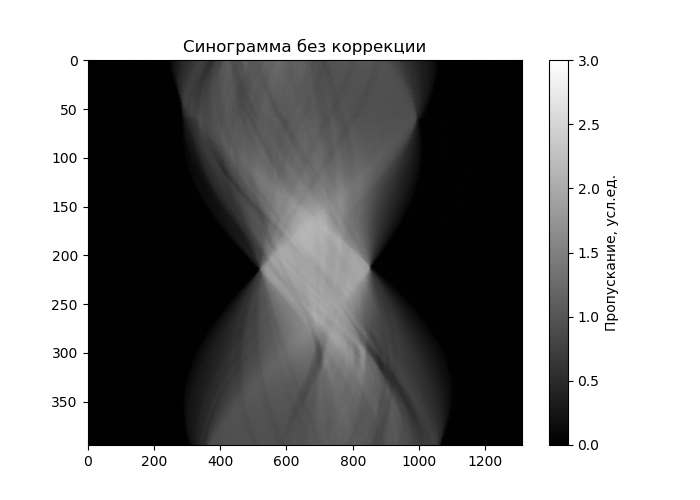

Text(0.5, 1.0, 'Синограмма без коррекции')

In [95]:
plt.gray()
plt.figure(figsize=(7,5))
plt.imshow(sinogram[np.argsort(uniq_angles),:,int(sinogram.shape[-1]//2)],
           vmin=0, vmax=3, interpolation='bilinear')
plt.axis('tight')
cbar = plt.colorbar()
cbar.set_label('Пропускание, усл.ед.', rotation=90)
plt.title('Синограмма без коррекции')

In [ ]:
# # build frames for video
# images_dir = os.path.join(tmp_dir,'images')
# tomotools.mkdir_p(images_dir)
# im_max=np.max(sinogram)
# im_min=np.min(sinogram)
# print(im_min, im_max)
# for ia, a in tomotools.log_progress(list(enumerate(np.argsort(uniq_angles)))):
# #     print('{:34}'.format(ia))
#     plt.imsave(os.path.join(images_dir,'prj_{:03}.png'.format(ia)),
#                np.rot90(sinogram[a],3), vmin=im_min, vmax=im_max,
#                cmap=plt.cm.gray_r)

# !cd {images_dir} && avconv -r 10 -i "prj_%03d.png" -b:v 1000k prj.avi
# !cd {images_dir} && rm prj.mp4

<IPython.core.display.Javascript object>


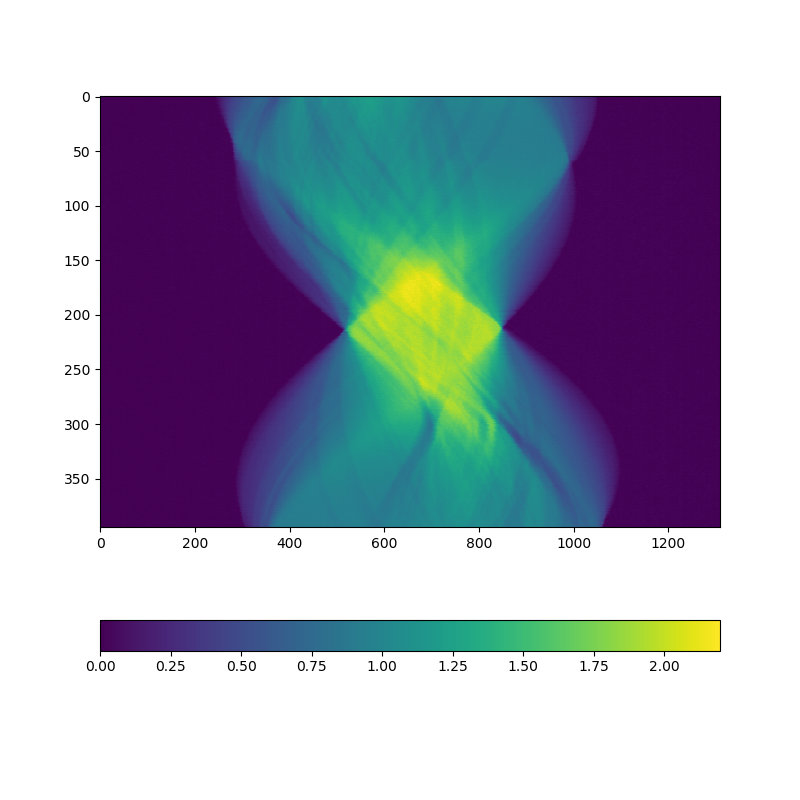

In [96]:
tmp_sinogram = sinogram[np.argsort(uniq_angles),:,int(sinogram.shape[-1]//2)+3]

plt.figure(figsize=(8,8))
plt.imshow(tmp_sinogram, cmap=plt.cm.viridis, interpolation='nearest')
plt.axis('tight')
plt.colorbar(orientation='horizontal')

In [79]:
import scipy.ndimage
def my_rc(sino0, level):
    def get_my_b(level):
        t= np.mean(sino0, axis=0)
        gt = scipy.ndimage.filters.gaussian_filter1d(t,level/2.)
        return gt-t
    
    def get_my_a(level):
        my_b = get_my_b(level)
        return np.mean(my_b)/my_b.shape[0]
    
    my_a = get_my_a(level)
    my_b = get_my_b(level)
    
    res = sino0.copy()
    if not level==0:
        res+= sino0*my_a+my_b
    
    return res

In [100]:
rc_level=5

<IPython.core.display.Javascript object>


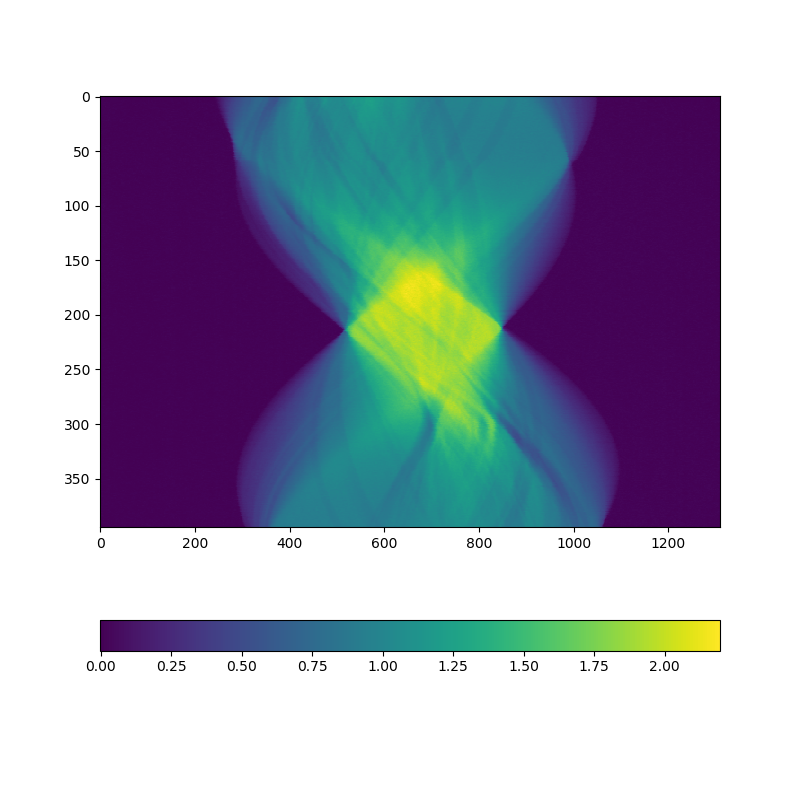

In [101]:
plt.figure(figsize=(8,8))
plt.imshow(my_rc(tmp_sinogram, rc_level), cmap=plt.cm.viridis, interpolation='nearest')
plt.axis('tight')
plt.colorbar(orientation='horizontal')

In [82]:
for s in tqdm_notebook(range(sinogram.shape[1])):
    sinogram[:,s,:] = my_rc(sinogram[:,s,:], rc_level)

<IPython.core.display.Javascript object>


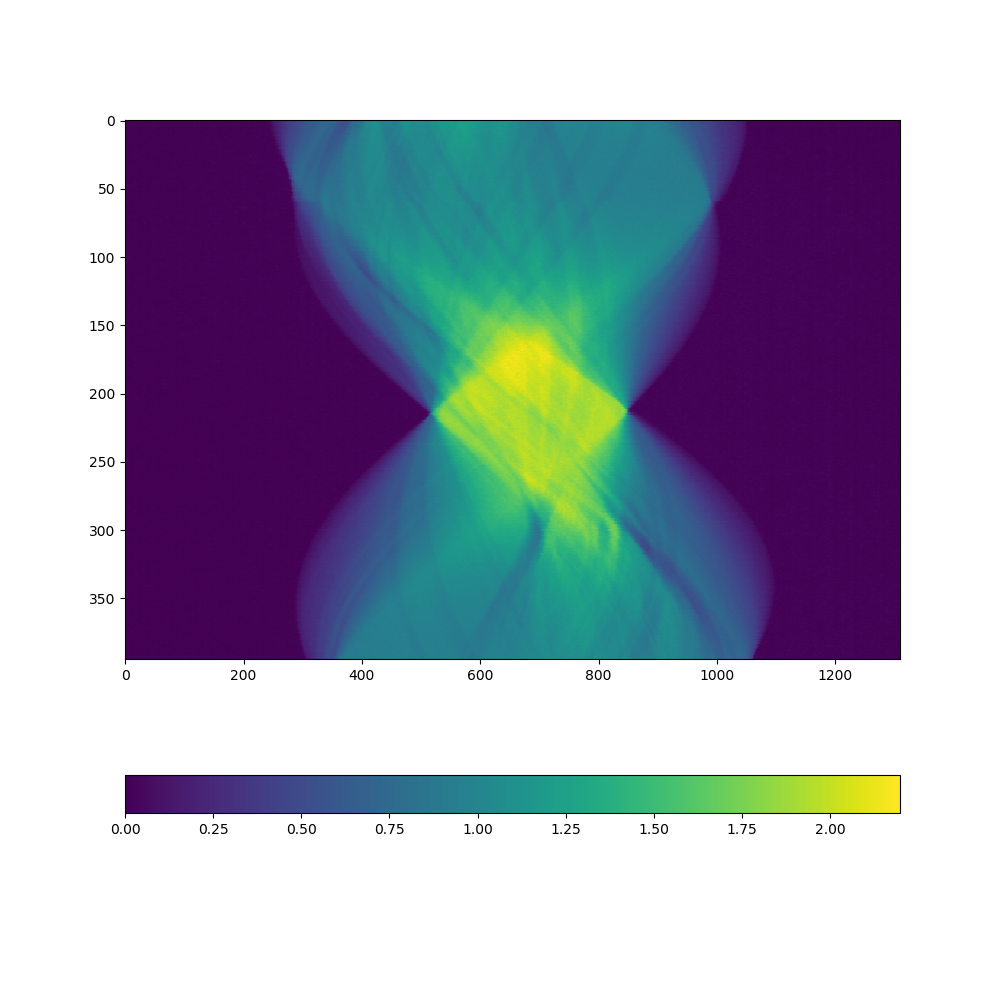

In [102]:
tmp_sinogram = sinogram[np.argsort(uniq_angles),:,int(sinogram.shape[-1]//2)+3]

plt.figure(figsize=(10,10))
plt.imshow(tmp_sinogram, cmap=plt.cm.viridis, interpolation='nearest')
plt.axis('tight')
plt.colorbar(orientation='horizontal')

In [84]:
from skimage.measure import compare_ssim, compare_nrmse
from scipy.ndimage.filters import gaussian_filter
from scipy.optimize import minimize
from scipy.linalg import norm
import cv2 

def cv_rotate(x, angle):
    """
    Rotate square array using OpenCV2 around center of the array
    :param x: 2d numpy array
    :param angle: angle in degrees
    :return: rotated array
    """
    x_center = tuple(
        np.array((x.shape[1], x.shape[0]), dtype='float32') / 2.0 - 0.5)
    rot_mat = cv2.getRotationMatrix2D(x_center, angle, 1.0)
    xro = cv2.warpAffine(
        x, rot_mat, (x.shape[1], x.shape[0]), flags=cv2.INTER_LINEAR)
    return xro

def smooth(x):
    return x - gaussian_filter(x,50)+gaussian_filter(x,10)


def find_axis_posiotion(image_0, image_180):
    
    def corr(x):
        alfa= x[0]
        shift_x = int(x[1])
        if shift_x >= 0:
            t_180 = image_180[:,shift_x:]
            t_0 = image_0[:,shift_x:]
        else:
            t_180 = image_180[:,:shift_x]
            t_0 = image_0[:,:shift_x]


        tt_180 = np.fliplr(cv_rotate(t_180,alfa))
        tt_180 = cv2.medianBlur(tt_180, 3) #*t_mask
        tt_0 = cv_rotate(t_0,alfa)
        tt_0 = cv2.medianBlur(tt_0, 3) #*t_mask

        res = compare_nrmse(tt_0, tt_180)

        return res

    s180 = image_180.sum(axis=0)
    r180 = np.flipud(np.arange(len(s180)))
    p180 = (s180*r180).sum()/s180.sum()


    s0 = image_0.sum(axis=0)
    r0 = np.arange(len(s0))
    p0 = (s0*r0).sum()/s0.sum()

    x0 = [1.,0.5*(p0-p180)]


    left = x0[1]-200
    right = x0[1]+200
    qq = [corr([0,q]) for q in np.arange(left,right)]
    min_pos = left+np.argmin(qq)
    if min_pos==left or min_pos==right:
        position_found = False
    else:
        position_found = True

    plt.figure()
    plt.plot(np.arange(left,right),qq)
    plt.grid()
    plt.show()

    while not position_found:
        if min_pos == left:
            right=left
            left=right-200
        elif min_pos == right:
            left=right
            right = left+200

        qq = [corr([0,q]) for q in np.arange(left,right)]
        min_pos = left+np.argmin(qq)
        if min_pos==left or min_pos==right:
            position_found = False
        else:
            position_found = True

        plt.figure()
        plt.plot(np.arange(left,right),qq)
        plt.grid()
        plt.show()


    shift_0 = min_pos
    x0 = [1.,shift_0],
    res= minimize(corr, x0, method='Powell')
    return res

In [103]:
# seraching opposite frames (0 and 180 deg)
def get_angles_at_180_deg(uniq_angles):  
    for zero_angle in uniq_angles:
        position_0 = np.argwhere(np.isclose(uniq_angles, zero_angle, atol=0.05))[0][0]
        position_180 = np.argwhere(np.isclose(uniq_angles, 180+zero_angle, atol=0.05))
        if len(position_180)>0:
            position_180=position_180[0][0]
            print(uniq_angles[position_0], position_0)
            print(uniq_angles[position_180], position_180)
            break
    return position_0, position_180

position_0, position_180 = get_angles_at_180_deg(uniq_angles)

posiotion_180_sorted = np.argwhere(np.isclose(position_180, np.argsort(uniq_angles)))[0][0]
print(posiotion_180_sorted)
posiotions_to_check = np.argsort(uniq_angles)[
    posiotion_180_sorted-3:np.min([posiotion_180_sorted+5, len(uniq_angles)-1])]  #TODO: check ranges
print(uniq_angles[posiotions_to_check])

0.0 0
180.0 189
355
[178.5 179.  179.5 180.  180.5 181.  181.5 182. ]


In [104]:
data_0_orig = np.rot90(sinogram[position_0]).copy()
data_0 = cv2.medianBlur(data_0_orig,3)
data_0 = smooth(data_0)

<IPython.core.display.Javascript object>


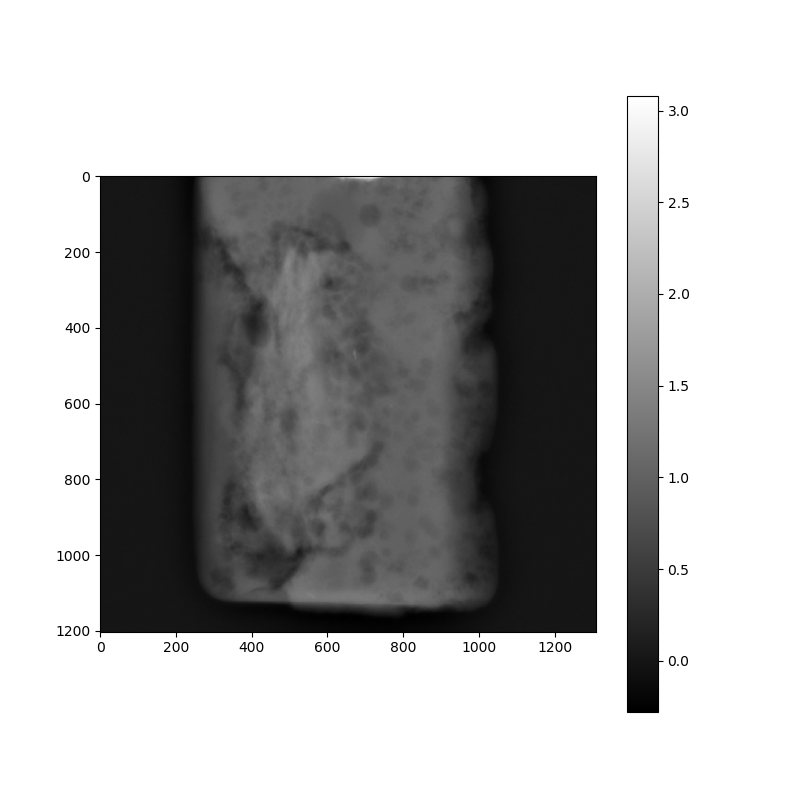

In [105]:
plt.figure(figsize=(8,8))
plt.imshow(smooth(data_0_orig))
plt.colorbar()

178.5


<IPython.core.display.Javascript object>


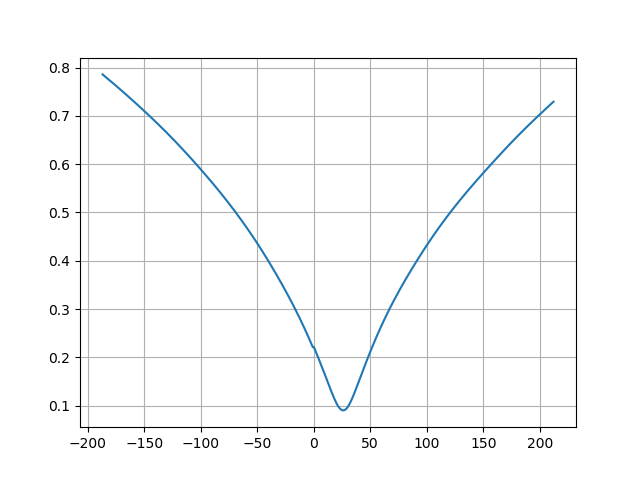

   direc: array([[ 0.        ,  1.        ],
       [-0.00975541,  0.00781247]])
     fun: 0.08195543858672853
 message: 'Optimization terminated successfully.'
    nfev: 122
     nit: 2
  status: 0
 success: True
       x: array([-0.27995568, 27.19210775])


<IPython.core.display.Javascript object>


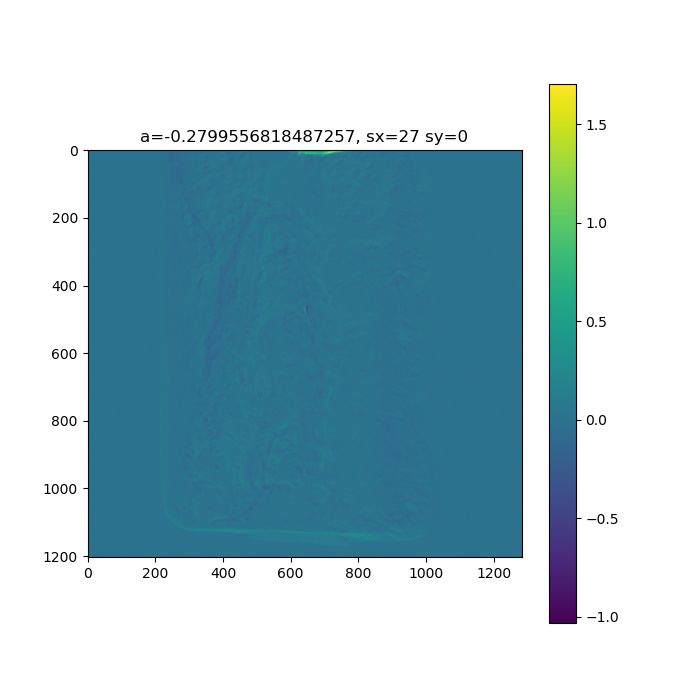

179.0


<IPython.core.display.Javascript object>


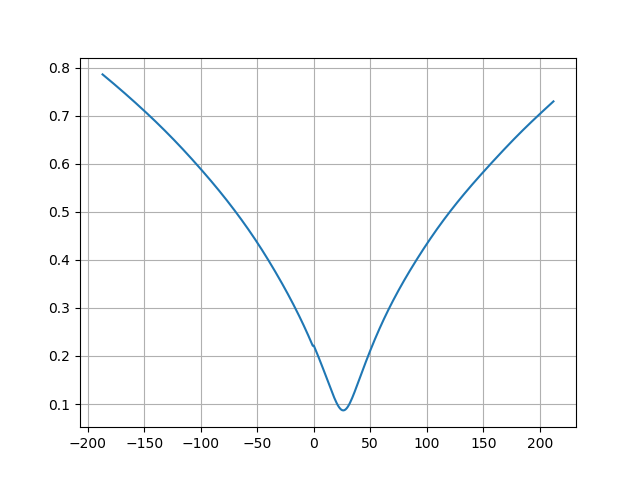

   direc: array([[ 0.        ,  1.        ],
       [-0.01538896,  0.01239752]])
     fun: 0.07843165280215875
 message: 'Optimization terminated successfully.'
    nfev: 116
     nit: 2
  status: 0
 success: True
       x: array([-0.27804954, 27.15281425])


<IPython.core.display.Javascript object>


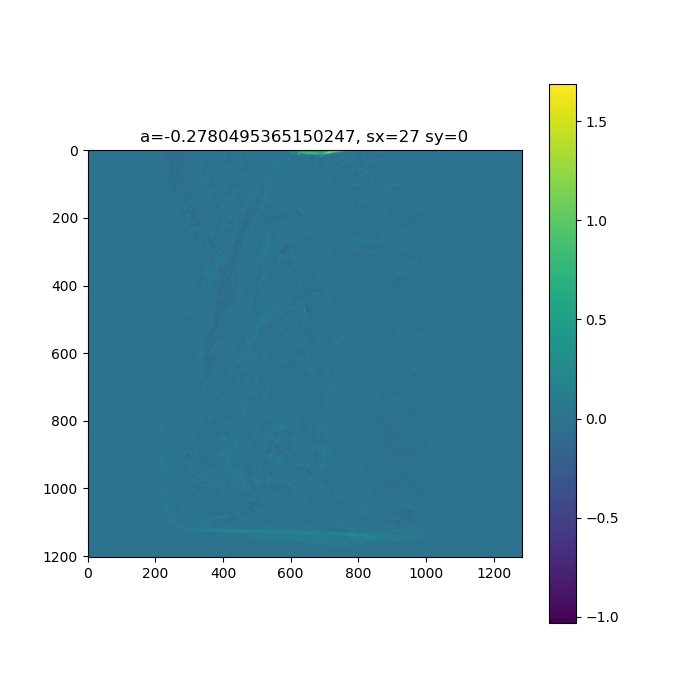

179.5


<IPython.core.display.Javascript object>


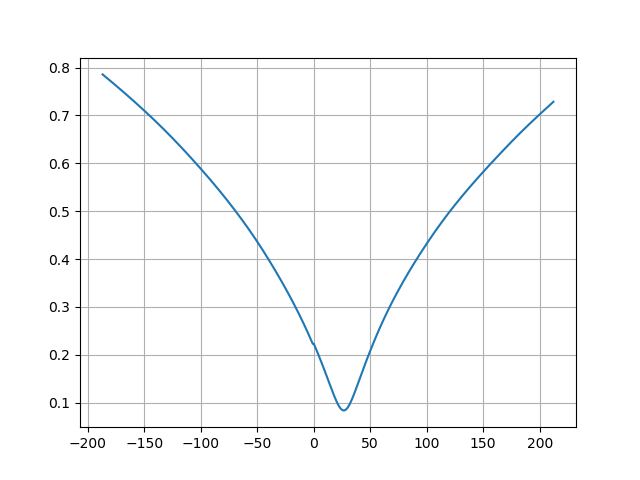

   direc: array([[ 0.        ,  1.        ],
       [-0.01864346,  0.01518697]])
     fun: 0.075637735688864
 message: 'Optimization terminated successfully.'
    nfev: 121
     nit: 2
  status: 0
 success: True
       x: array([-0.2675303 , 27.23196997])


<IPython.core.display.Javascript object>


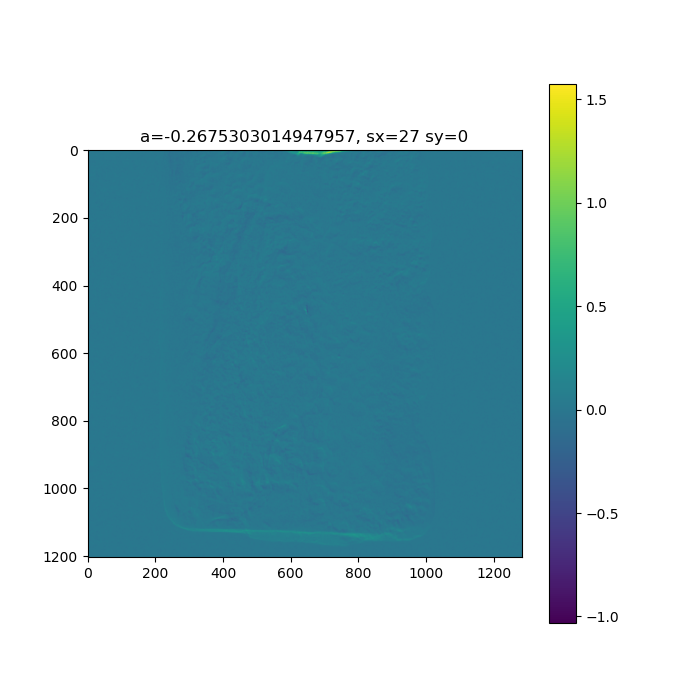

180.0


<IPython.core.display.Javascript object>


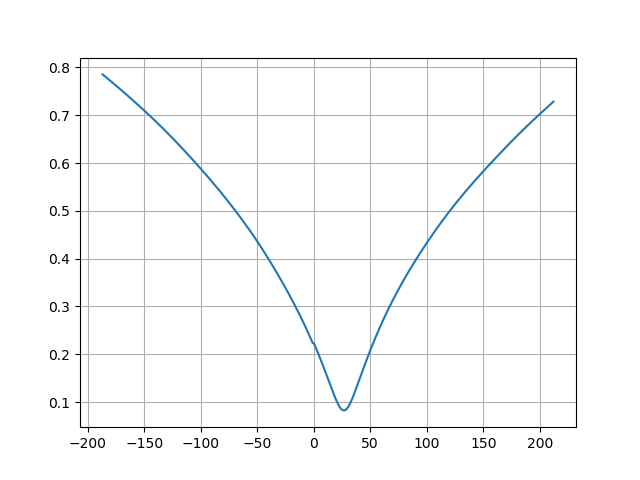

   direc: array([[ 0.00000000e+00,  1.00000000e+00],
       [-3.36780433e-03,  4.77061669e-14]])
     fun: 0.07443269043967235
 message: 'Optimization terminated successfully.'
    nfev: 231
     nit: 3
  status: 0
 success: True
       x: array([-0.25544537, 27.15786322])


<IPython.core.display.Javascript object>


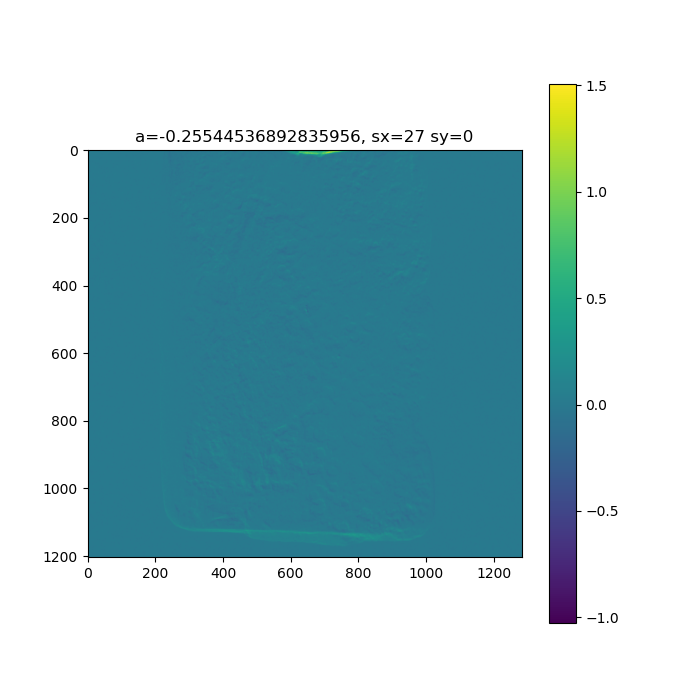

180.5


<IPython.core.display.Javascript object>


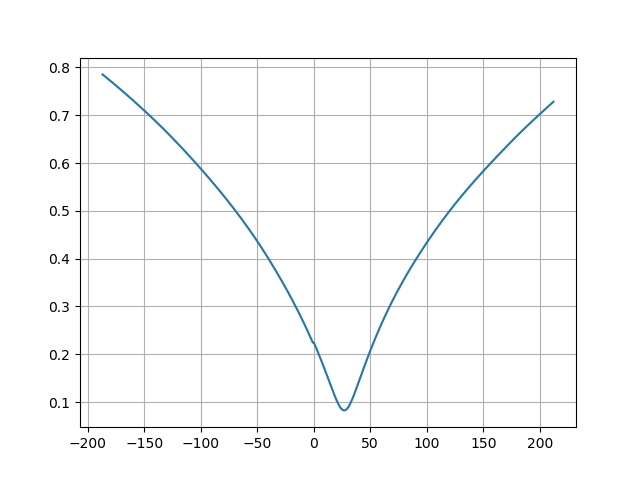

   direc: array([[ 0.        ,  1.        ],
       [-0.01863727,  0.01526336]])
     fun: 0.07512518741386454
 message: 'Optimization terminated successfully.'
    nfev: 112
     nit: 2
  status: 0
 success: True
       x: array([-0.25895263, 28.1800038 ])


<IPython.core.display.Javascript object>


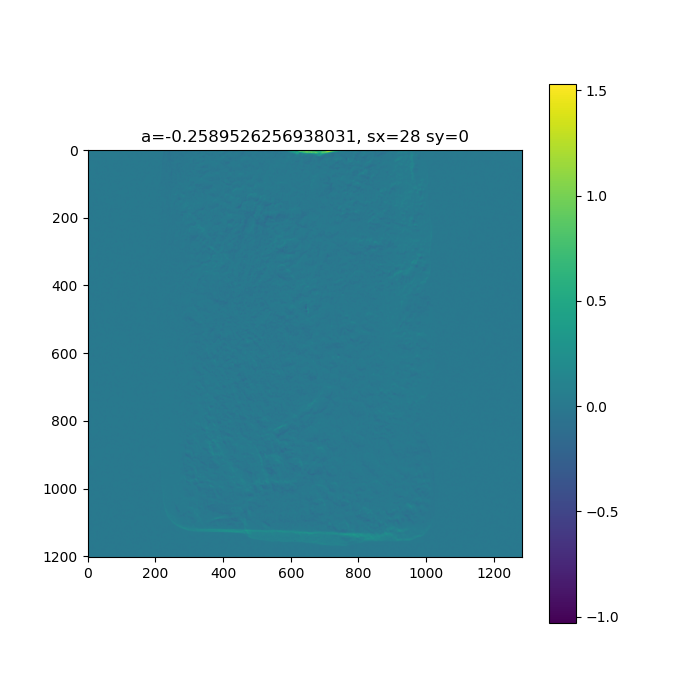

181.0


<IPython.core.display.Javascript object>


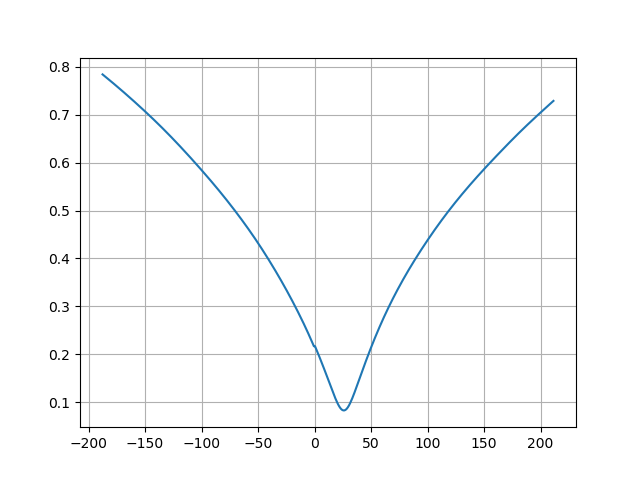

   direc: array([[ 0.00000000e+00,  1.00000000e+00],
       [-1.01677902e-02,  1.46655086e-13]])
     fun: 0.0758156042748444
 message: 'Optimization terminated successfully.'
    nfev: 166
     nit: 2
  status: 0
 success: True
       x: array([-0.24197013, 26.39986813])


<IPython.core.display.Javascript object>


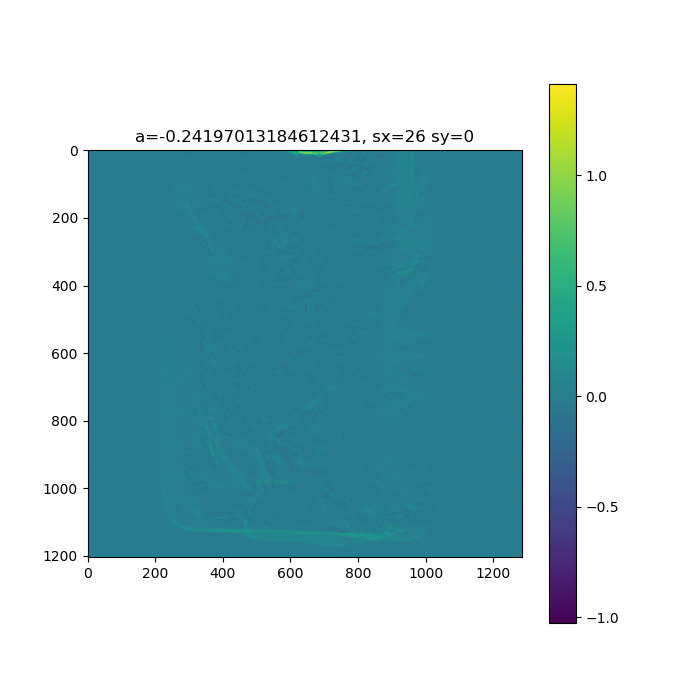

181.5


<IPython.core.display.Javascript object>


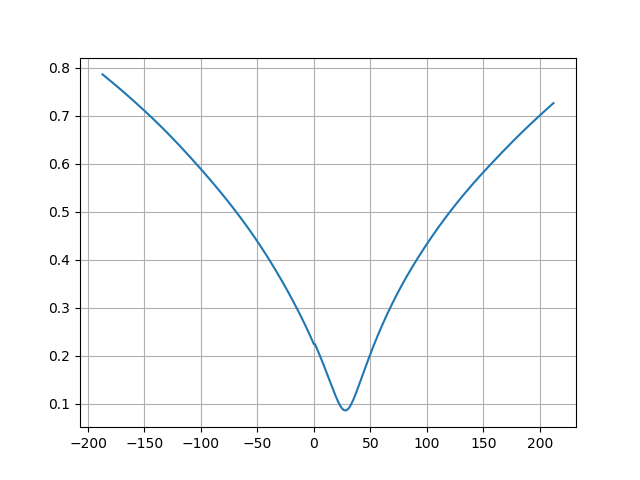

   direc: array([[0.        , 1.        ],
       [0.0146111 , 0.00716366]])
     fun: 0.08011940664982693
 message: 'Optimization terminated successfully.'
    nfev: 131
     nit: 2
  status: 0
 success: True
       x: array([-0.22423024, 27.32456628])


<IPython.core.display.Javascript object>


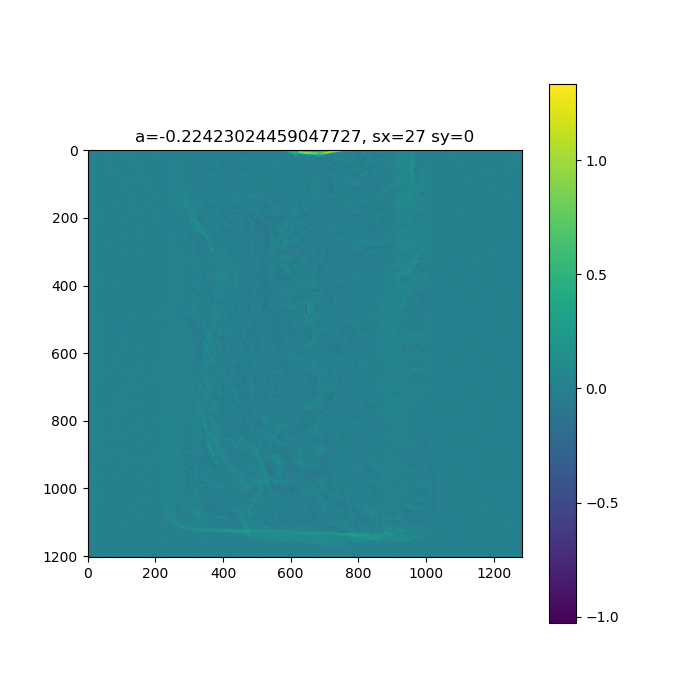

182.0


<IPython.core.display.Javascript object>


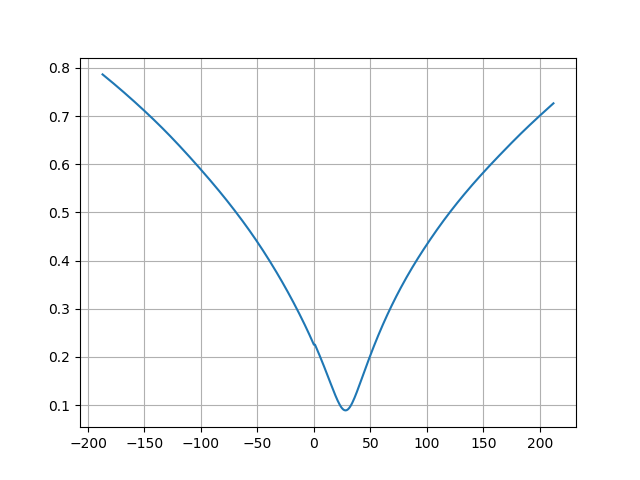

   direc: array([[ 0.        ,  1.        ],
       [-0.02938202,  0.01540088]])
     fun: 0.08405985921574699
 message: 'Optimization terminated successfully.'
    nfev: 118
     nit: 2
  status: 0
 success: True
       x: array([-0.22869594, 28.55864776])


<IPython.core.display.Javascript object>


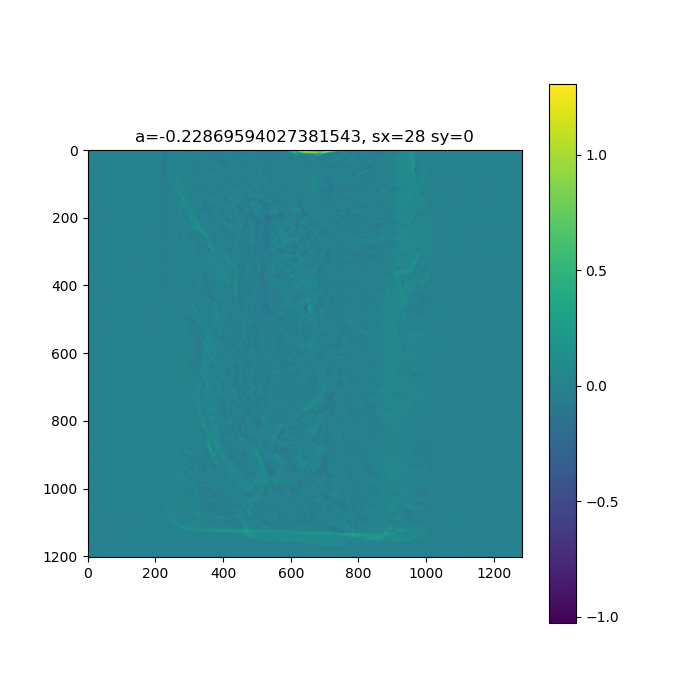

In [108]:
opt_func_values = []
for position_180 in posiotions_to_check:
    print(uniq_angles[position_180])
    data_0_orig = np.rot90(sinogram[position_0]).copy()
    data_180_orig = np.rot90(sinogram[position_180]).copy()
    data_0 = cv2.medianBlur(data_0_orig,3)
    data_180 = cv2.medianBlur(data_180_orig,3)

    data_0 = smooth(data_0)
    data_180 = smooth(data_180)
    
    res = find_axis_posiotion(data_0, data_180)
    opt_func_values.append(res['fun'])
    print(res)
    # alfa, shift_x, shift_y = res.x[0]/10, int(res.x[1]), int(res.x[2])//10

    alfa, shift_x, shift_y = res.x[0], int(np.floor(res.x[1])), 0

    if shift_x >= 0:
        t_180 = data_180_orig[:,shift_x:]
        t_0 = data_0_orig[:,shift_x:]
    else:
        t_180 = data_180_orig[:,:shift_x]
        t_0 = data_0_orig[:,:shift_x]

    if shift_y > 0:
        t_180 = t_180[shift_y:,:]
        t_0 = t_0[:-shift_y,:]
    elif shift_y < 0:
        t_180 = t_180[:shift_y,:]
        t_0 = t_0[-shift_y:,:]


    tt_180 = np.fliplr(cv_rotate(t_180,alfa))
    tt_0 = cv_rotate(t_0,alfa)

    plt.figure(figsize=(7,7))
    plt.imshow(tt_180-tt_0, cmap=plt.cm.viridis)
    plt.title('a={}, sx={} sy={}'.format(alfa,shift_x, shift_y))
    plt.colorbar()
    plt.show()

<IPython.core.display.Javascript object>


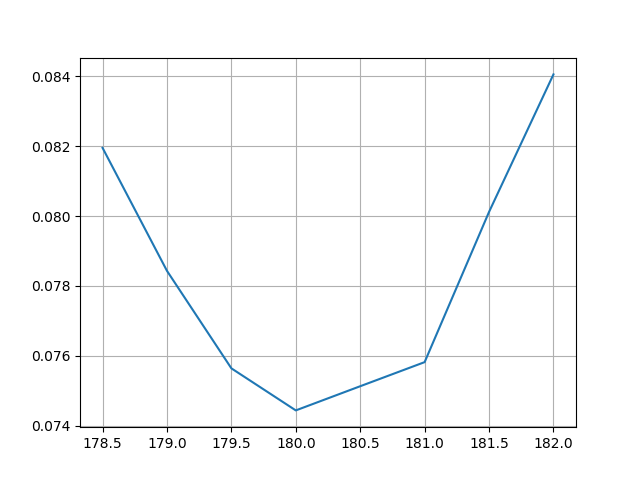

189


In [109]:
plt.figure()
plt.plot(uniq_angles[posiotions_to_check],opt_func_values)
plt.grid()
new_position_180 = posiotions_to_check[np.argmin(opt_func_values)]
print(new_position_180)

In [110]:
uniq_angles_orig = uniq_angles.copy()
uniq_angles *= 180./uniq_angles[new_position_180]
position_0, position_180 = get_angles_at_180_deg(uniq_angles)

0.0 0
180.0 189


180.0


<IPython.core.display.Javascript object>


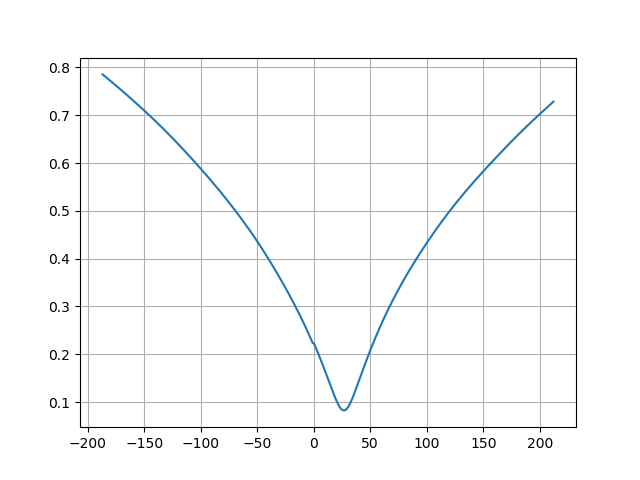

   direc: array([[ 0.00000000e+00,  1.00000000e+00],
       [-3.36780433e-03,  4.77061669e-14]])
     fun: 0.07443269043967235
 message: 'Optimization terminated successfully.'
    nfev: 231
     nit: 3
  status: 0
 success: True
       x: array([-0.25544537, 27.15786322])


<IPython.core.display.Javascript object>


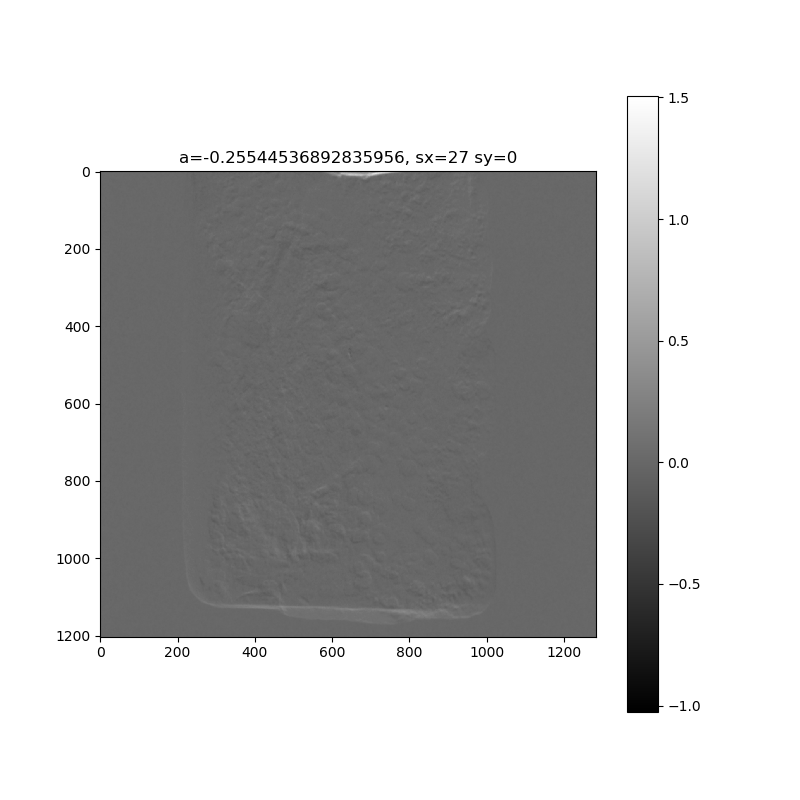

In [112]:
print(uniq_angles[position_180])
data_0_orig = np.rot90(sinogram[position_0]).copy()
data_180_orig = np.rot90(sinogram[position_180]).copy()
data_0 = cv2.medianBlur(data_0_orig,3)
data_180 = cv2.medianBlur(data_180_orig,3)

data_0 = smooth(data_0)
data_180 = smooth(data_180)

res = find_axis_posiotion(data_0, data_180)
# opt_func_values.append(res['fun'])
print(res)

alfa, shift_x, shift_y = res.x[0], int(np.floor(res.x[1])), 0

if shift_x >= 0:
    t_180 = data_180_orig[:,shift_x:]
    t_0 = data_0_orig[:,shift_x:]
else:
    t_180 = data_180_orig[:,:shift_x]
    t_0 = data_0_orig[:,:shift_x]

if shift_y > 0:
    t_180 = t_180[shift_y:,:]
    t_0 = t_0[:-shift_y,:]
elif shift_y < 0:
    t_180 = t_180[:shift_y,:]
    t_0 = t_0[-shift_y:,:]


tt_180 = np.fliplr(cv_rotate(t_180,alfa))
tt_0 = cv_rotate(t_0,alfa)

plt.figure(figsize=(8,8))
plt.imshow(tt_180-tt_0, cmap=plt.cm.viridis)
plt.title('a={}, sx={} sy={}'.format(alfa,shift_x, shift_y))
plt.colorbar()
plt.show()

<IPython.core.display.Javascript object>


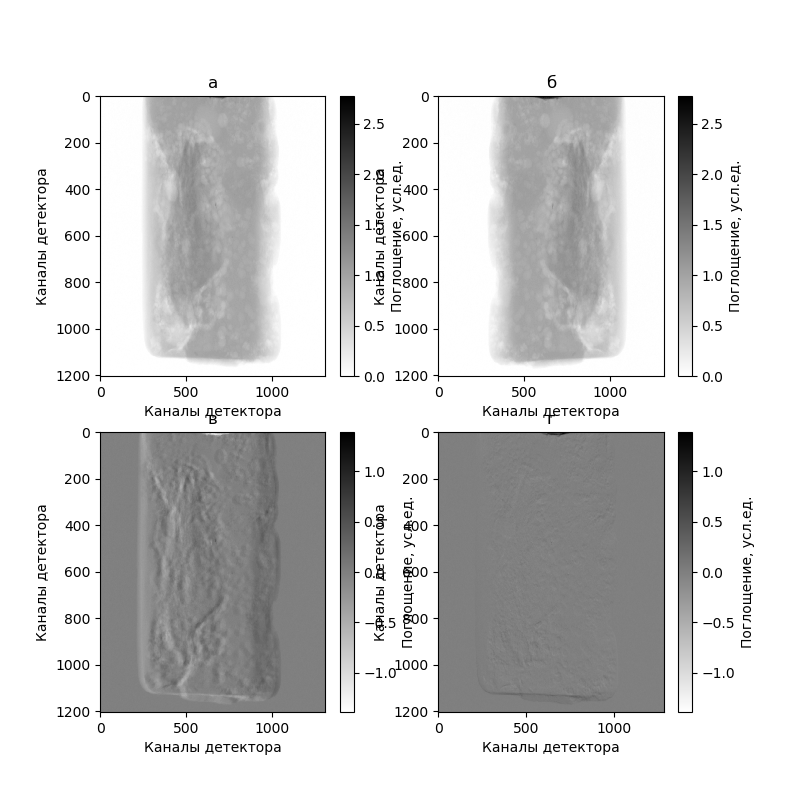

In [113]:
plt.gray()
plt.figure(figsize=(8,8))
im_max = np.max([np.max(data_0_orig), np.max(data_180_orig)])
plt.subplot(221)
plt.imshow(data_0_orig, vmin=0, vmax=im_max, cmap=plt.cm.gray_r)
plt.axis('tight')
plt.title('a')
plt.xlabel('Каналы детектора')
plt.ylabel('Каналы детектора')
cbar = plt.colorbar()
cbar.set_label('Поглощение, усл.ед.', rotation=90)

plt.subplot(222)
plt.imshow(data_180_orig, vmin=0, vmax=im_max, cmap=plt.cm.gray_r)
plt.axis('tight')
plt.title('б')
plt.xlabel('Каналы детектора')
plt.ylabel('Каналы детектора')
cbar = plt.colorbar()
cbar.set_label('Поглощение, усл.ед.', rotation=90)

plt.subplot(223)
plt.imshow(data_0_orig - np.fliplr(data_180_orig), vmin=-im_max/2, vmax=im_max/2, cmap=plt.cm.gray_r)
plt.axis('tight')
plt.title('в')
plt.xlabel('Каналы детектора')
plt.ylabel('Каналы детектора')
cbar = plt.colorbar()
cbar.set_label('Поглощение, усл.ед.', rotation=90)

plt.subplot(224)
# alfa = 0.1
# shift = -77
plt.imshow(1.0*(tt_180-tt_0), vmin=-im_max/2, vmax=im_max/2, cmap=plt.cm.gray_r)
plt.axis('tight')
plt.title('г')
plt.xlabel('Каналы детектора')
plt.ylabel('Каналы детектора')
cbar = plt.colorbar()
cbar.set_label('Поглощение, усл.ед.', rotation=90)


# plt.figure(figsize=(7, 5))
# plt.plot(np.arange(left,right),qq)
# plt.xlabel('Сдвиг позиции оси вращения, каналы детектора')
# plt.ylabel('Значение оптимизируемой функции')
# plt.grid()
# plt.show()

# plt.colorbar(orientation='horizontal')
# plt.imshow(uniq_data_images[np.argsort(uniq_angles),:,int(sinogram.shape[-1]//2)],
#            vmin=0, vmax=1, interpolation='bilinear')
# plt.axis('tight')
# cbar = plt.colorbar()
# cbar.set_label('Пропускание, усл.ед.', rotation=90)
# plt.title('Синограмма без коррекции')

In [114]:
sinogram_fixed, _ = tomotools.load_create_mm(os.path.join(tmp_dir,'sinogram_fixed.tmp'),
                                shape=(sinogram.shape[0], sinogram.shape[1]+abs(shift_x),sinogram.shape[2]),
                                dtype='float32', force_create=True)

#fix axis tlit
for i in tqdm_notebook(range(sinogram.shape[0])):
    t = sinogram[i].copy()
#     if shift_x > 0:
#         t = t[shift_x:]
#     elif shift_x < 0:
#         t = t[:shift_x]
    t_angle = uniq_angles[i]
    
    if not shift_y ==0 :
        delta_angle = t_angle - uniq_angles[position_0]+90
        tmp_shift_y = int(np.sin(delta_angle/180.*np.pi)*shift_y)
        t = np.roll(t, -tmp_shift_y, -1)
        t[:,0:np.abs(shift_y)]=0
        t[:,-np.abs(shift_y):]=0
        
    t = cv_rotate(t, alfa)
    if shift_x>0:
        sinogram_fixed[i, :-shift_x] = t
    else:
        sinogram_fixed[i, -shift_x:] = t
    

INFO:root:Force create
INFO:root:Creating new file: /diskmnt/fast/makov/robotom/907e8b4b-541e-49a1-835e-3a88863437f2/sinogram_fixed.tmp


In [115]:
s1 = np.require(sinogram_fixed[np.argsort(uniq_angles),:,int(sinogram_fixed.shape[-1]//2)],
                dtype=np.float32, requirements=['C'])

<IPython.core.display.Javascript object>


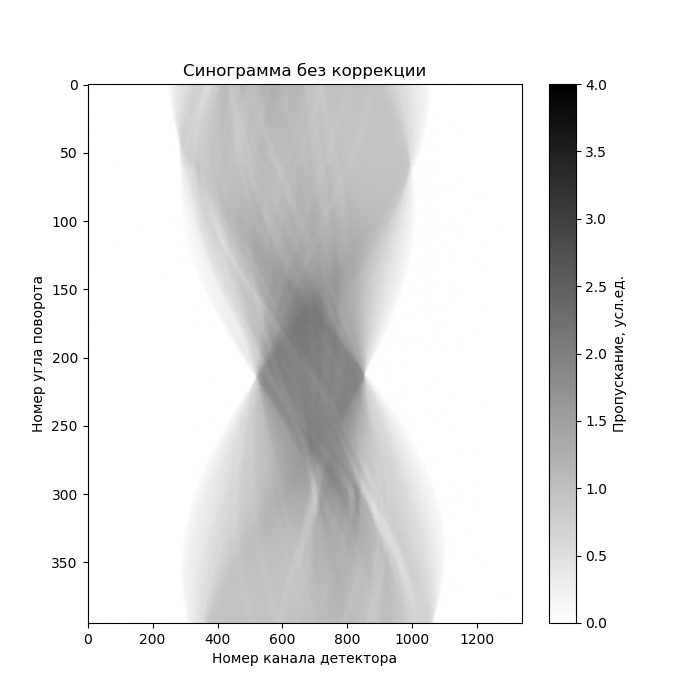

Text(0, 0.5, 'Номер угла поворота')

In [116]:
plt.figure(figsize=(7,7))

plt.imshow(s1,
           vmin=0, vmax=4, interpolation='bilinear', cmap=plt.cm.gray_r)
plt.axis('tight')
cbar = plt.colorbar()
cbar.set_label('Пропускание, усл.ед.', rotation=90)
plt.title('Синограмма без коррекции')
plt.xlabel('Номер канала детектора')
plt.ylabel('Номер угла поворота')

In [117]:
#TODO: check mu physical value
sinogram_fixed_median = np.median(sinogram_fixed.sum(axis=-1).sum(axis=-1))
corr_factor = sinogram_fixed.sum(axis=-1).sum(axis=-1)/sinogram_fixed_median

In [118]:
#TODO: fix bad data
for i in range(len(sinogram_fixed)):
    sinogram_fixed[i] = sinogram_fixed[i]/corr_factor[i]

In [119]:
s2 = np.require(sinogram_fixed[np.argsort(uniq_angles),:,int(sinogram_fixed.shape[-1]//2)],
                dtype=np.float32, requirements=['C'])

<IPython.core.display.Javascript object>


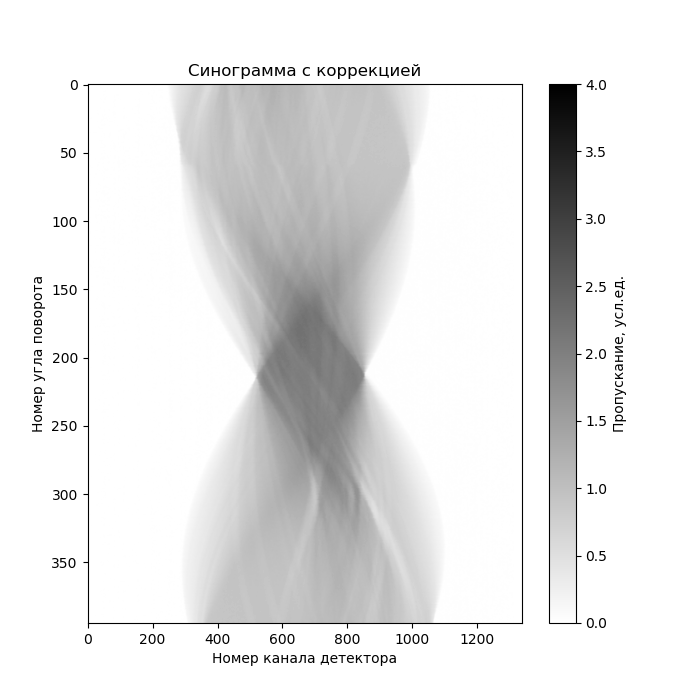

<IPython.core.display.Javascript object>


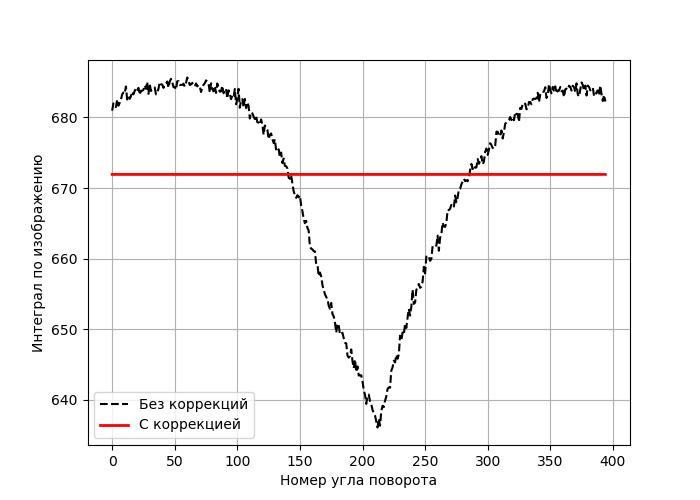

In [120]:
plt.figure(figsize=(7,7))

s2 = (s1.T/s1.sum(axis=-1)*s1.sum(axis=-1).mean()).T

plt.imshow(s2,
           vmin=0, vmax=4, interpolation='bilinear', cmap=plt.cm.gray_r)
plt.axis('tight')
cbar = plt.colorbar()
cbar.set_label('Пропускание, усл.ед.', rotation=90)
plt.title('Синограмма c коррекцией')
plt.xlabel('Номер канала детектора')
plt.ylabel('Номер угла поворота')

plt.figure(figsize=(7, 5))
plt.plot(s1.sum(axis=-1),'k--', label='Без коррекций')
plt.plot(s2.sum(axis=-1), 'r', lw=2, label='С коррекцией')
plt.xlabel('Номер угла поворота')
plt.ylabel('Интеграл по изображению')
plt.grid()
plt.legend()
plt.show()

In [123]:
%whos

Variable                Type                Data/Info
-----------------------------------------------------
A                       float64             3.013723877834778
C                       float64             1.02519495962619
STORAGE_SERVER          str                 http://10.0.7.153:5006/
alfa                    float64             -0.25544536892835956
astra                   module              <module 'astra' from '/ho<...>kages/astra/__init__.py'>
ax                      AxesImage           AxesImage(100,111.416;620x569.168)
cbar                    Colorbar            <matplotlib.colorbar.Colo<...>object at 0x7f09845d3cc0>
compare_nrmse           function            <function compare_nrmse at 0x7f09ca8dd510>
compare_psnr            function            <function compare_psnr at 0x7f09ca8dd598>
compare_ssim            function            <function compare_ssim at 0x7f09ca8dd620>
configparser            module              <module 'configparser' fr<...>thon3.6/configparser.py'

In [122]:
del data_0_orig, data_180_orig, data_images_good, data_images_masked
del sinogram, sinogram_fixed, uniq_angles, uniq_angles_orig, uniq_data_images 

In [124]:
!ls {tmp_dir}

data_images_good.tmp	      group_empty_angles.tmp
data_images_good.tmp.size     group_empty_angles.tmp.size
data_images_masked.tmp	      group_empty.tmp
data_images_masked.tmp.size   group_empty.tmp.size
empty_images_masked.tmp       rec.tmp
empty_images_masked.tmp.size  rec.tmp.size
group_dark_angles.tmp	      sinogram_fixed.tmp
group_dark_angles.tmp.size    sinogram_fixed.tmp.size
group_dark.tmp		      sinogram.tmp
group_dark.tmp.size	      sinogram.tmp.size
group_data_angles.tmp	      uniq_angles.tmp
group_data_angles.tmp.size    uniq_angles.tmp.size
group_data.tmp		      uniq_data_images.tmp
group_data.tmp.size	      uniq_data_images.tmp.size


In [129]:
files_to_remove = glob(os.path.join(tmp_dir,'*.tmp'))
files_to_remove = [f for f in files_to_remove if f.split('/')[-1] not in [
                                'uniq_angles.tmp', 'sinogram_fixed.tmp']]

for fr in files_to_remove:
    try:
        os.remove(os.path.join(tmp_dir,fr))
    except:
        pass
    try:
        os.remove(os.path.join(tmp_dir,fr+'.size'))
    except:
        pass

In [134]:
uniq_angles, _ = tomotools.load_create_mm(os.path.join(tmp_dir,'uniq_angles.tmp'),
                             shape= None,
                             dtype='float32')
s1, _ = tomotools.load_create_mm(os.path.join(tmp_dir,'sinogram_fixed.tmp'),
                                shape= None,
                                dtype='float32')

rec_vol, _ = tomotools.load_create_mm(os.path.join(tmp_dir,'rec.tmp'),
               dtype=np.float32,
               shape = (s1.shape[-1],s1.shape[1],s1.shape[1]))



INFO:root:Loading existing file: /diskmnt/fast/makov/robotom/907e8b4b-541e-49a1-835e-3a88863437f2/uniq_angles.tmp
INFO:root:Loading existing file: /diskmnt/fast/makov/robotom/907e8b4b-541e-49a1-835e-3a88863437f2/sinogram_fixed.tmp
INFO:root:Creating new file: /diskmnt/fast/makov/robotom/907e8b4b-541e-49a1-835e-3a88863437f2/rec.tmp


In [135]:
pixel_size = 9e-3
def astra_tomo2d_parallel(sinogram, angles):
#     astra.astra.set_gpu_index([0,1])
    angles = angles.astype('float64')
    detector_size = sinogram.shape[1]
    

    rec_size = detector_size
    vol_geom = astra.create_vol_geom(rec_size, rec_size)
    proj_geom = astra.create_proj_geom('parallel', 1.0, detector_size, angles)


    sinogram_id = astra.data2d.create('-sino', proj_geom, data=sinogram)
    # Create a data object for the reconstruction
    rec_id = astra.data2d.create('-vol', vol_geom)
#     proj_id = astra.create_projector('strip', proj_geom, vol_geom) # for CPU reconstruction only
    # Set up the parameters for a reconstruction algorithm using the GPU
    cfg = astra.astra_dict('FBP_CUDA')
    cfg['ReconstructionDataId'] = rec_id
    cfg['ProjectionDataId'] = sinogram_id
#     cfg['ProjectorId'] = proj_id # for CPU reconstruction only
    cfg['option'] = {}
    
    alg_id = astra.algorithm.create(cfg)
    astra.algorithm.run(alg_id, 1)
    
    cfg = astra.astra_dict('CGLS_CUDA')
    cfg['ReconstructionDataId'] = rec_id
    cfg['ProjectionDataId'] = sinogram_id
#     cfg['ProjectorId'] = proj_id # for CPU reconstruction only
    cfg['option'] = {}
#     cfg['option']['MinConstraint'] = -0.01

    alg_id = astra.algorithm.create(cfg)
    
    # Run 150 iterations of the algorithm
    astra.algorithm.run(alg_id, 2)
    
    # Get the result
    rec = astra.data2d.get(rec_id)/pixel_size  #fixit
    
    # Clean up. Note that GPU memory is tied up in the algorithm object,
    # and main RAM in the data objects.
    astra.algorithm.delete(alg_id)
    astra.data2d.delete(rec_id)
    astra.data2d.delete(sinogram_id)
    astra.clear()
    return rec

def astra_tomo3d_parallel(sinogram, angles, rec_vol, slice_start, slice_stop):
#     astra.astra.set_gpu_index([0,1])
    angles = angles.astype('float64')
    detector_size = sinogram.shape[1]
#         slices_number = sinogram.shape[0]
    slices_number = slice_stop - slice_start
        
    rec_size = detector_size
    vol_geom = astra.create_vol_geom(rec_size, rec_size, slices_number)
    proj_geom = astra.create_proj_geom('parallel3d', 1.0, 1.0,  slices_number, detector_size, angles)


    sinogram_id = astra.data3d.create('-sino', proj_geom, np.rollaxis(sinogram,-1)[slice_start:slice_stop])
    # Create a data object for the reconstruction
#     rec_id = astra.data3d.link('-vol', vol_geom, rec_vol[slice_start:slice_stop])
    rec_id = astra.data3d.create('-vol', vol_geom)
    # Set up the parameters for a reconstruction algorithm using the GPU
    cfg = astra.astra_dict('CGLS3D_CUDA')
    cfg['ReconstructionDataId'] = rec_id
    cfg['ProjectionDataId'] = sinogram_id
#     cfg['ProjectorId'] = proj_id # for CPU reconstruction only
    cfg['option'] = {}
#     cfg['option']['GPUindex'] = 1
    cfg['option']['MinConstraint'] = -0.01

    # Available algorithms:
    # SIRT_CUDA, SART_CUDA, EM_CUDA, FBP_CUDA (see the FBP sample)

    # Create the algorithm object from the configuration structure
    alg_id = astra.algorithm.create(cfg)
#     astra.data3d.info()
    # Run 150 iterations of the algorithm
    astra.algorithm.run(alg_id, 30)
    
    # Get the result
    rec = astra.data3d.get(rec_id)/pixel_size  #fixit

    # Clean up. Note that GPU memory is tied up in the algorithm object,
    # and main RAM in the data objects.
    astra.algorithm.delete(alg_id)
    astra.data3d.delete(rec_id)
    astra.data3d.delete(sinogram_id)
    astra.clear()
    return rec

/home/makov/opt/anaconda/envs/xrecon/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


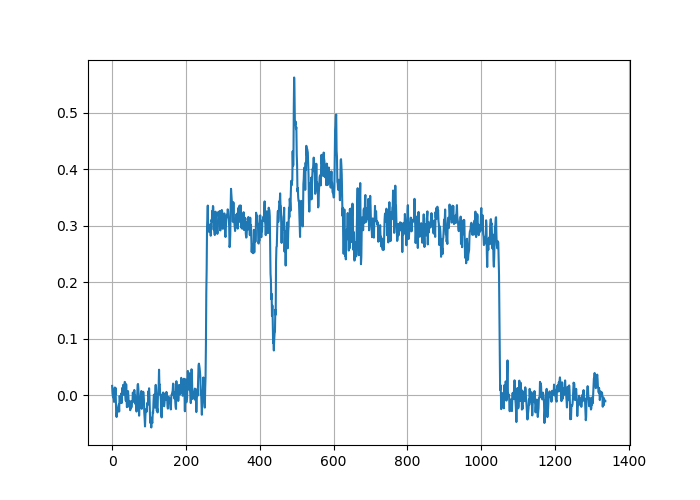

<IPython.core.display.Javascript object>


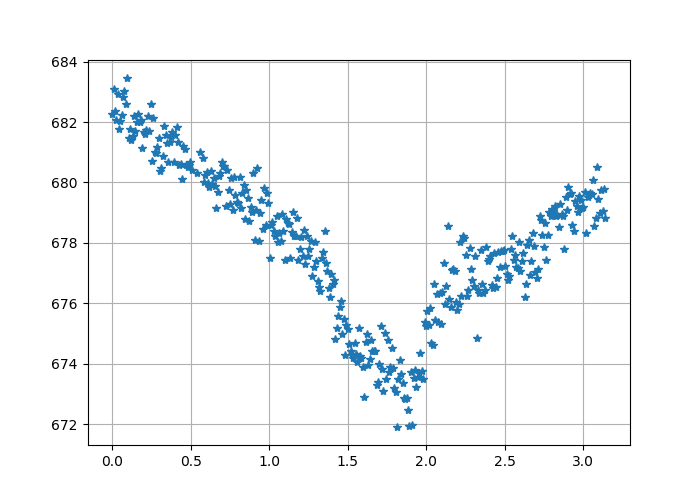

<IPython.core.display.Javascript object>


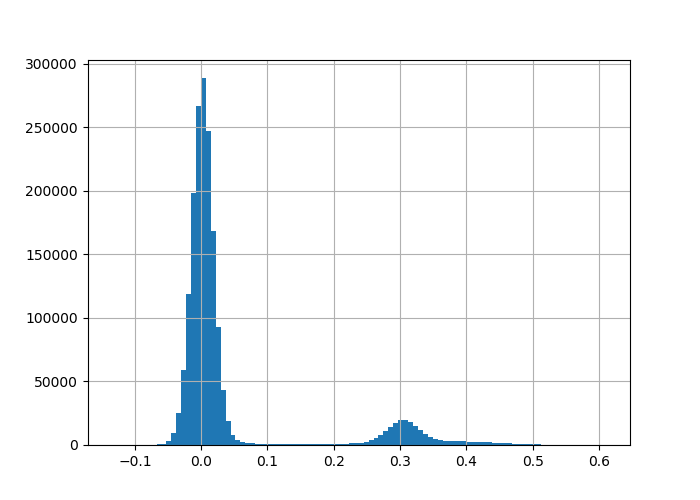

<IPython.core.display.Javascript object>


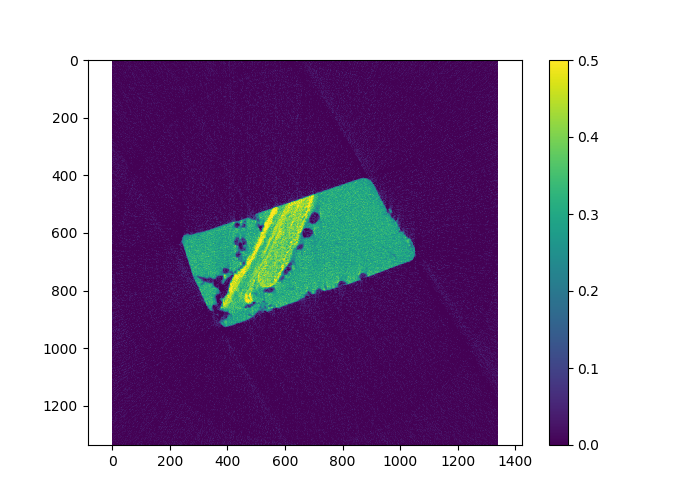

In [136]:
# %%timeit
#preview
bh_corr = 1.0
sss = s1[...,int(s1.shape[-1]/2)]
t_angles = (uniq_angles-uniq_angles.min())<=180 # remove angles >180
s4 = sss.copy()
s4[s4<0] = 0

rec_slice = astra_tomo2d_parallel(np.power(s4[t_angles],bh_corr), uniq_angles[t_angles]*np.pi/180)


plt.figure(figsize=(7,5))
plt.plot(rec_slice[rec_slice.shape[0]//2])
plt.grid()
plt.show()

plt.figure(figsize=(7,5))
plt.plot(uniq_angles[t_angles]*np.pi/180, 
         np.power(s4[t_angles],bh_corr).sum(axis=1)/np.sum(np.power(s4[t_angles],bh_corr))*np.sum(s4[t_angles]),
        '*')
plt.grid()
plt.show()


plt.figure(figsize=(7,5))
plt.hist(rec_slice.ravel(), bins=100)
plt.grid()
plt.show()


plt.figure(figsize=(7,5))
plt.imshow(rec_slice/np.sum(np.power(s4[t_angles],bh_corr))*np.sum(s4[t_angles]),
                                                                   vmin=0, vmax=0.5, cmap=plt.cm.viridis)
plt.axis('equal')
plt.colorbar()
plt.show()

In [137]:
#multi 2d case
t = time.time()
print(s1.shape)
angles =np.array(uniq_angles)*np.pi/180
for i in tqdm_notebook(range(0, s1.shape[-1])):
    sino = s1[:,:,i].copy()
    sino[sino<0] = 0
    sino = np.power(sino, bh_corr)  #BH!
    t_angles = (uniq_angles-uniq_angles.min())<=180 # remove angles >180
    rec_vol[i] = astra_tomo2d_parallel(sino[t_angles], angles[t_angles])
print(time.time()-t)

(395, 1337, 1203)



102.45550584793091


In [138]:
rec_vol_filtered = rec_vol

<IPython.core.display.Javascript object>


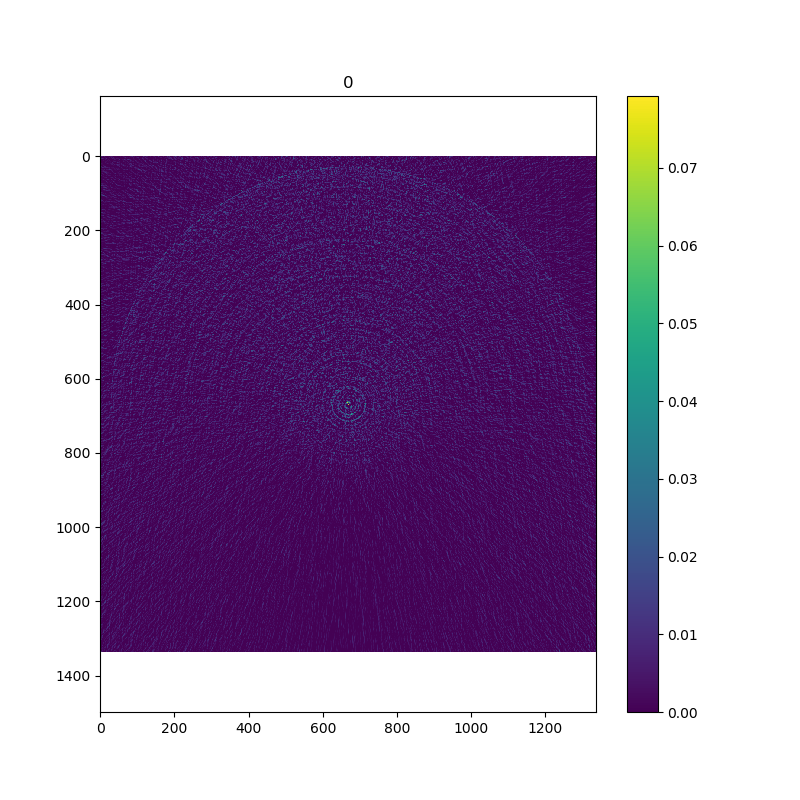

<IPython.core.display.Javascript object>


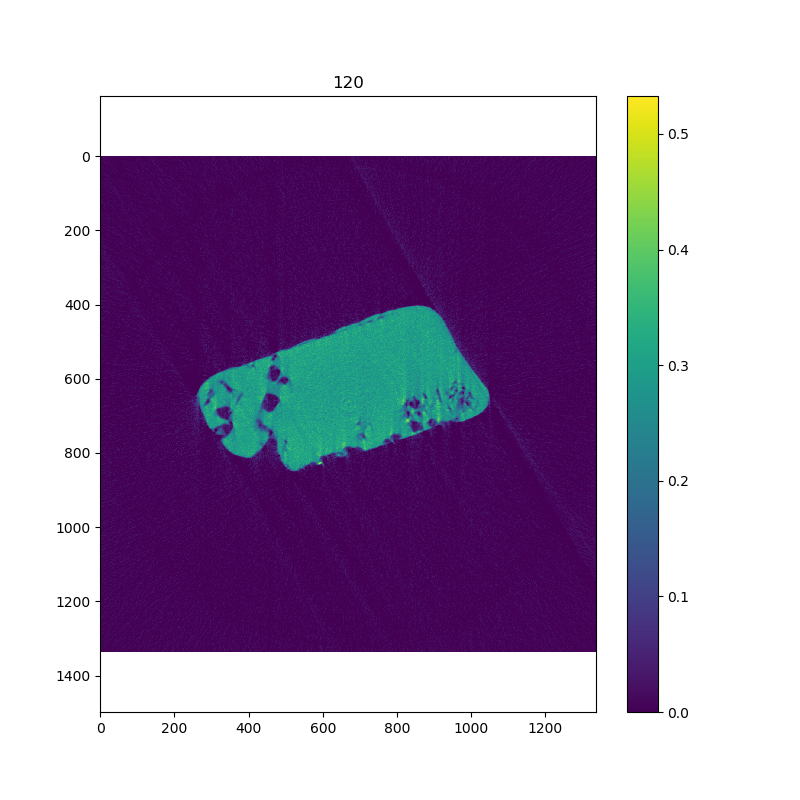

<IPython.core.display.Javascript object>


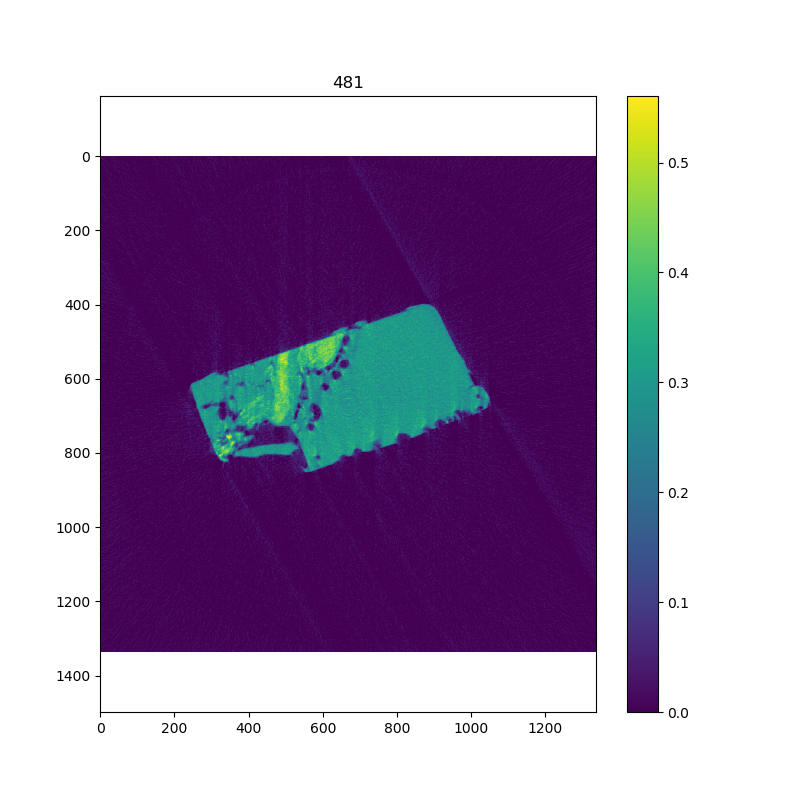

<IPython.core.display.Javascript object>


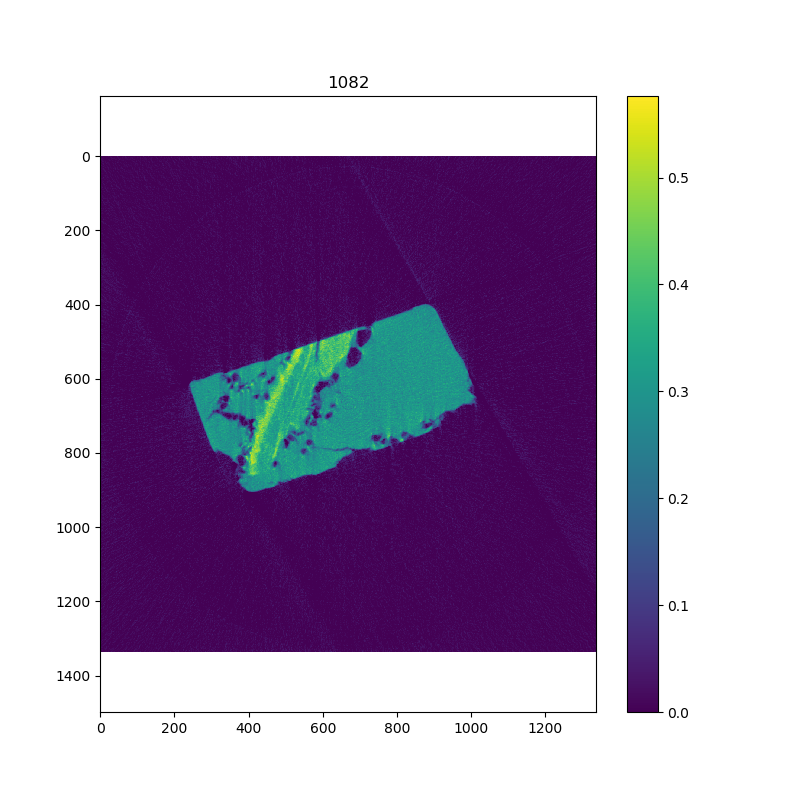

<IPython.core.display.Javascript object>


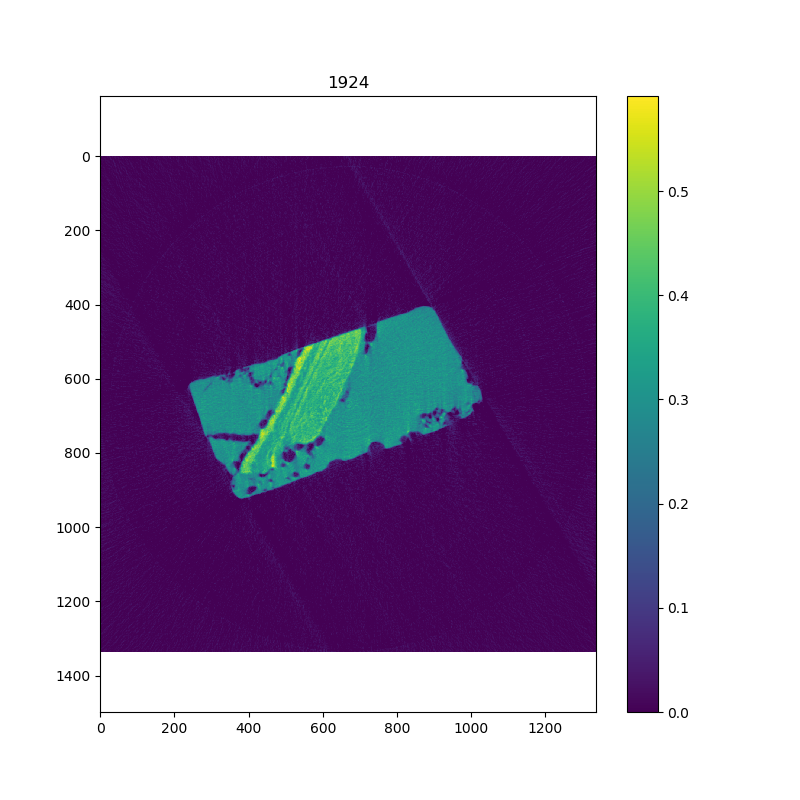

<IPython.core.display.Javascript object>


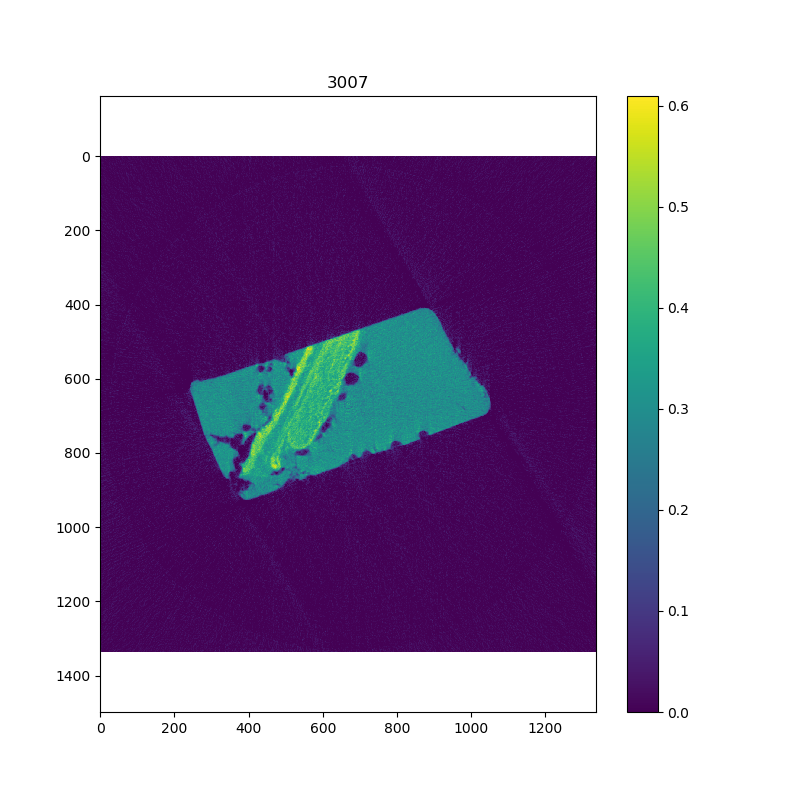

<IPython.core.display.Javascript object>


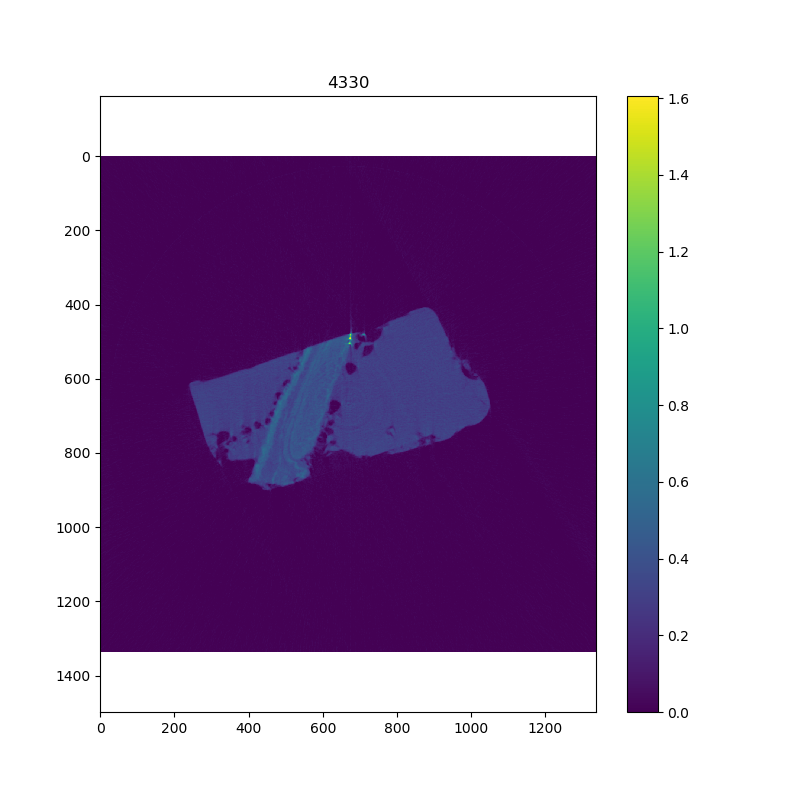

<IPython.core.display.Javascript object>


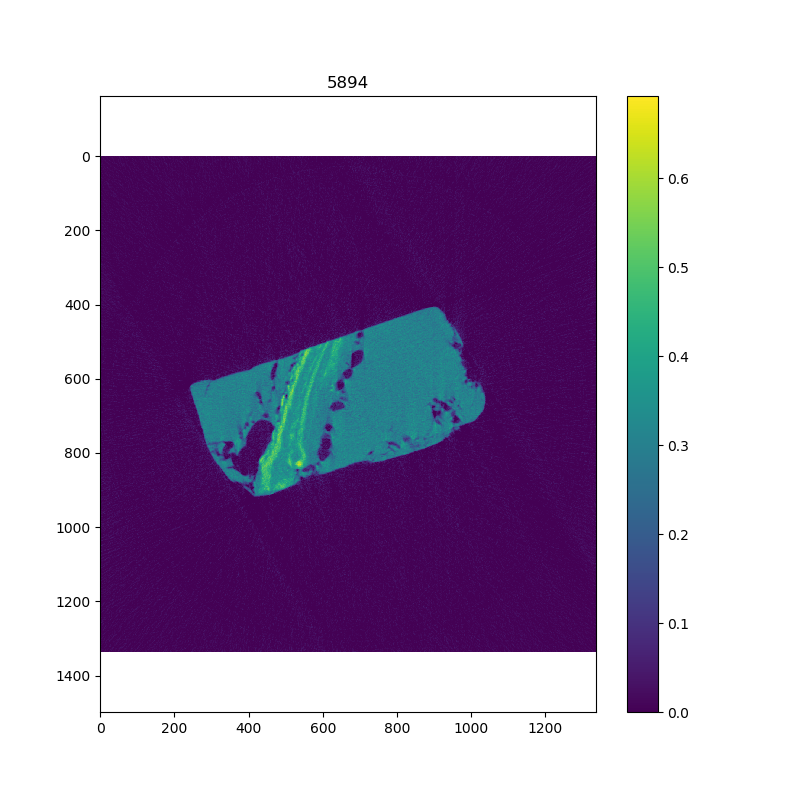

<IPython.core.display.Javascript object>


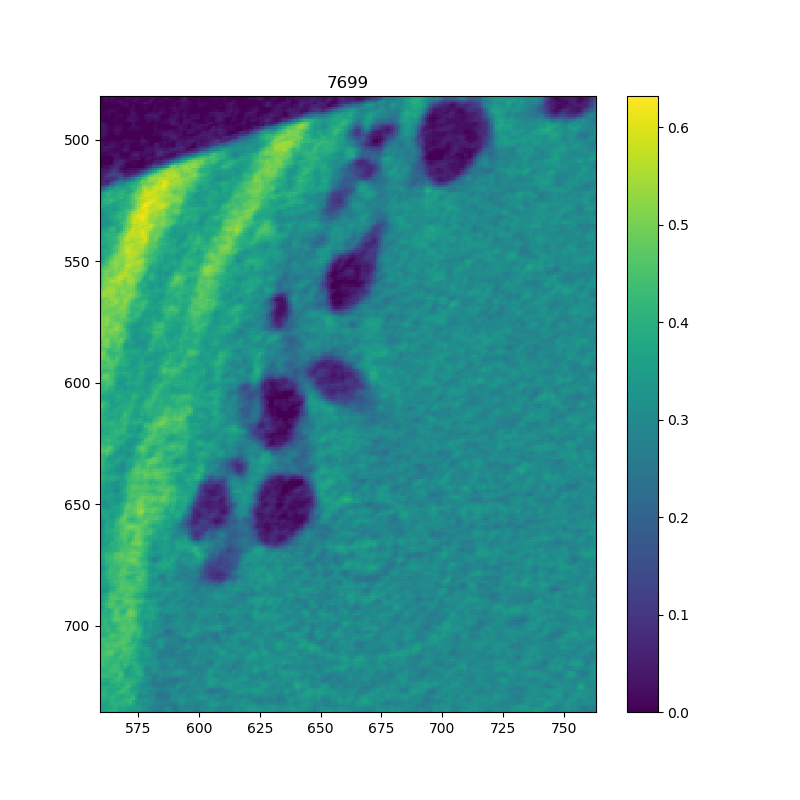

<IPython.core.display.Javascript object>


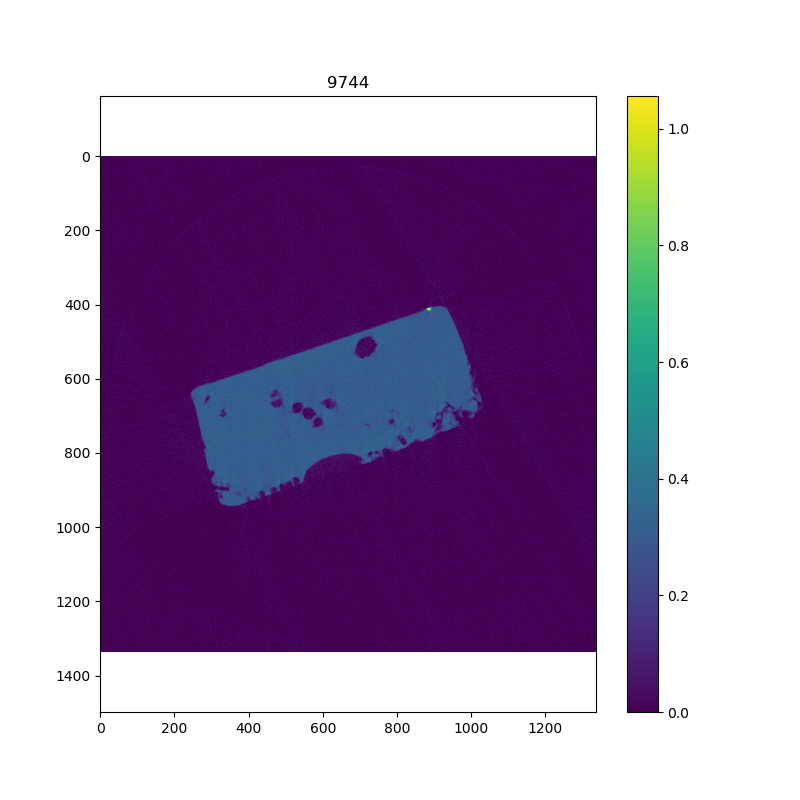

In [139]:
for i in range(10):
        plt.figure(figsize=(8,8))
        plt.imshow(rec_vol_filtered[i*rec_vol_filtered.shape[0]//10], cmap=plt.cm.viridis, vmin=0)
        plt.axis('equal')
        plt.title(i*i*rec_vol_filtered.shape[0]//10)
        plt.colorbar()
        plt.show()

<IPython.core.display.Javascript object>


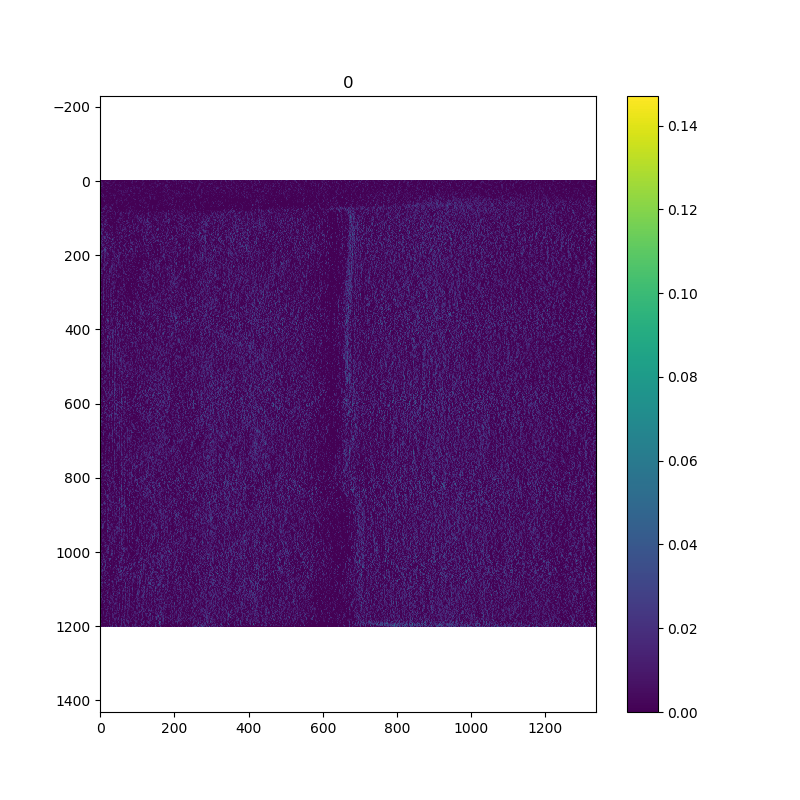

<IPython.core.display.Javascript object>


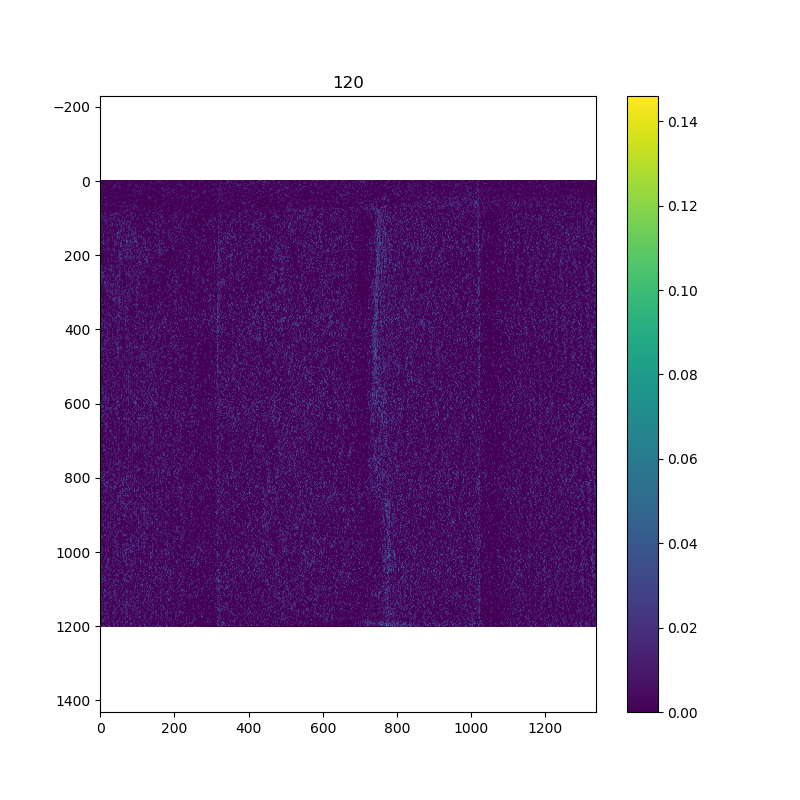

<IPython.core.display.Javascript object>


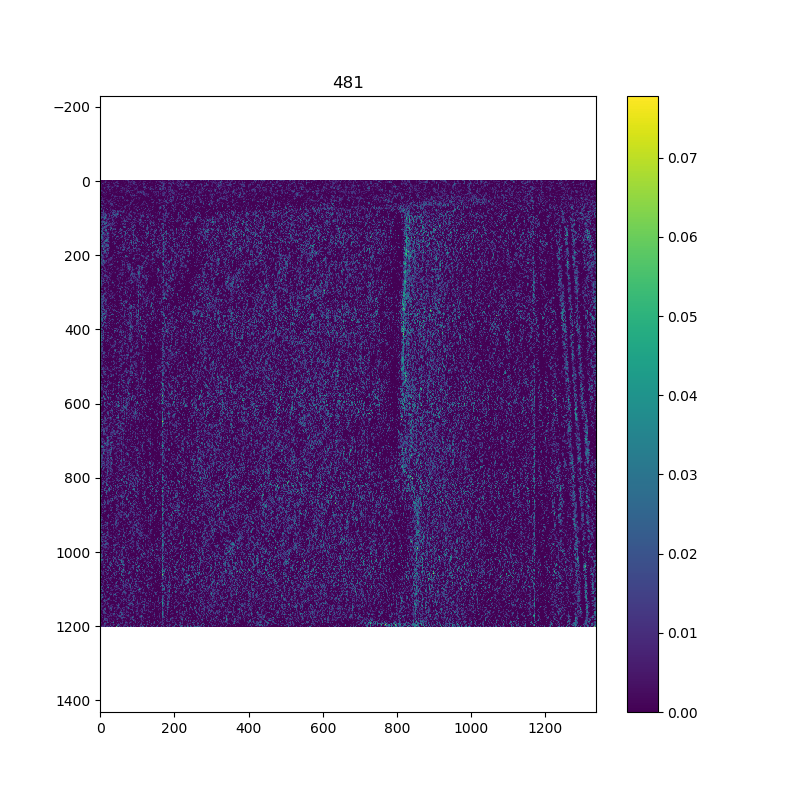

<IPython.core.display.Javascript object>


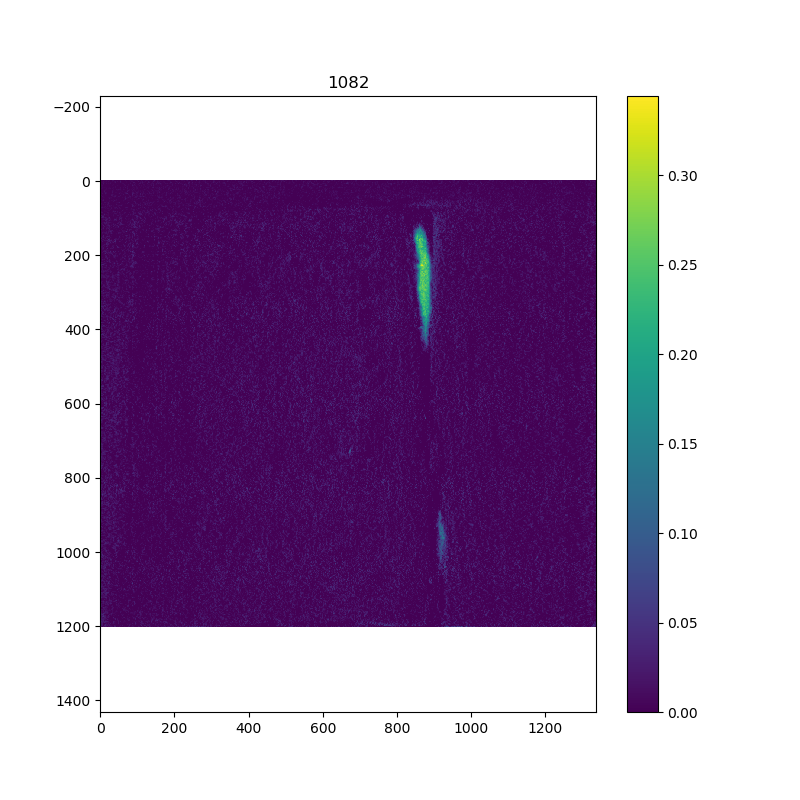

<IPython.core.display.Javascript object>


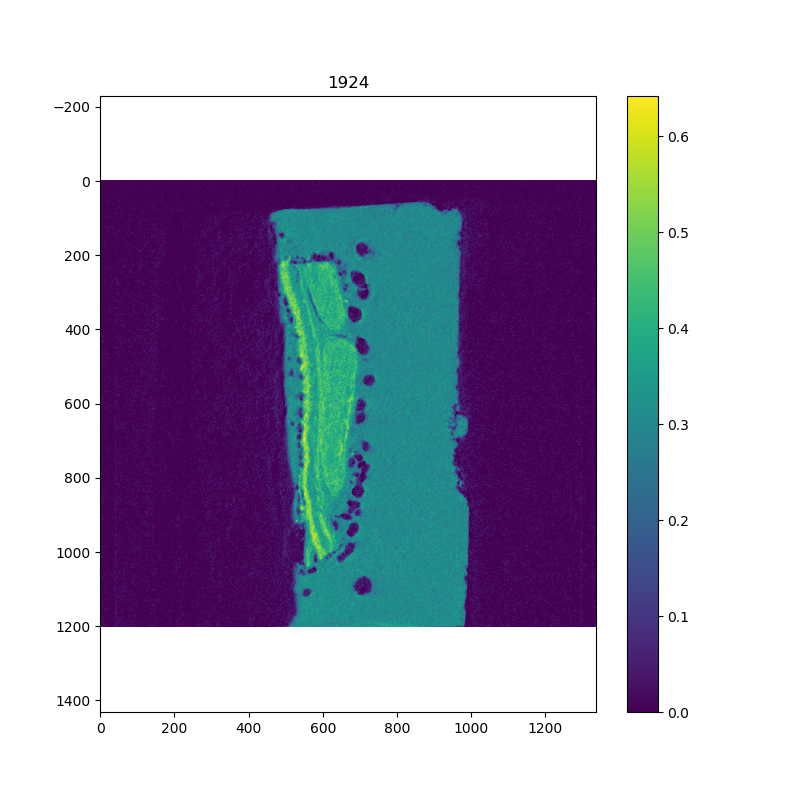

<IPython.core.display.Javascript object>


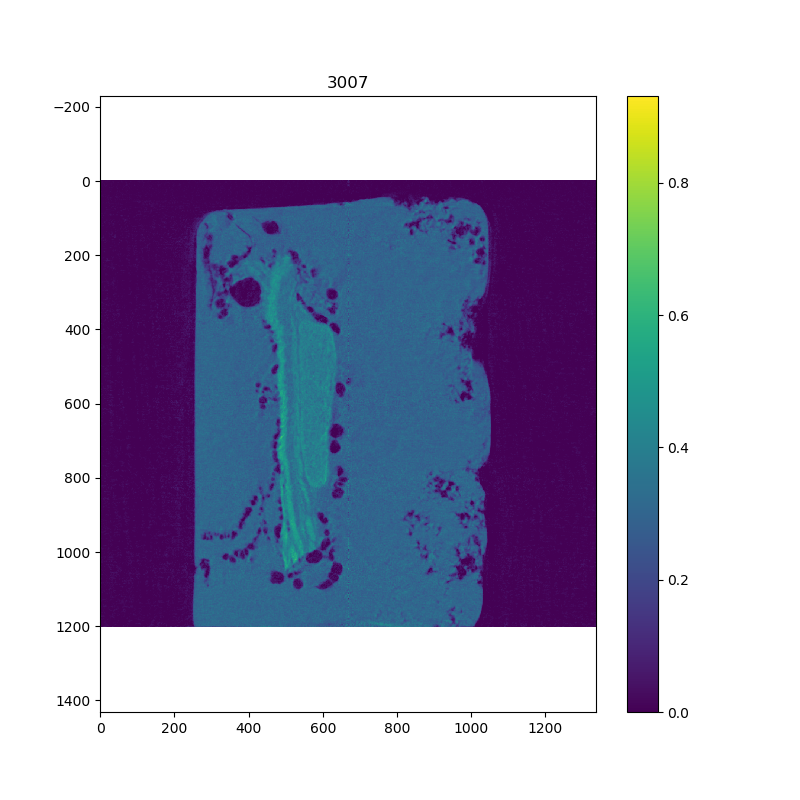

<IPython.core.display.Javascript object>


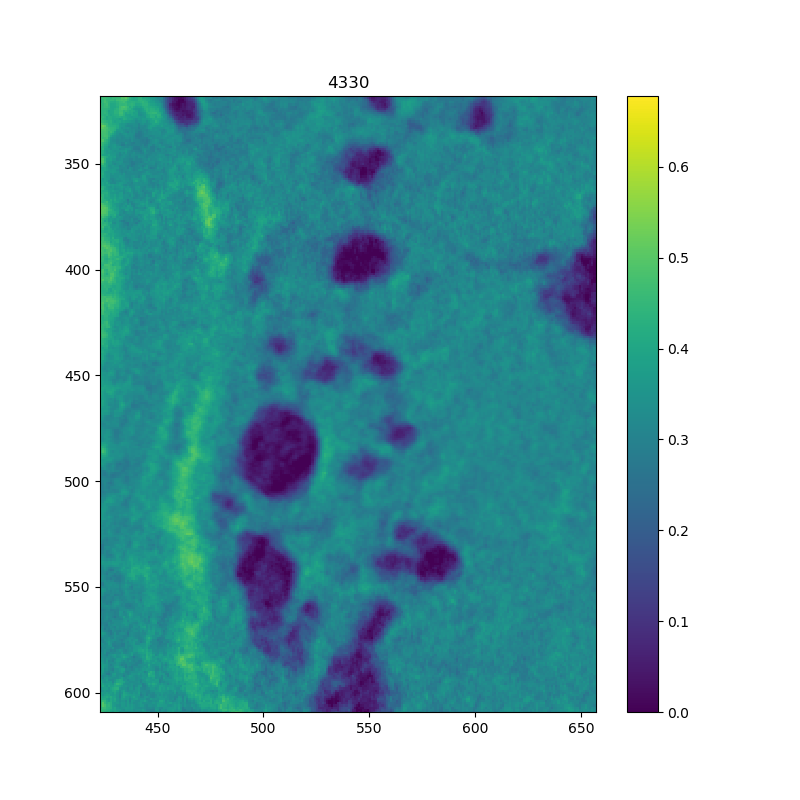

<IPython.core.display.Javascript object>


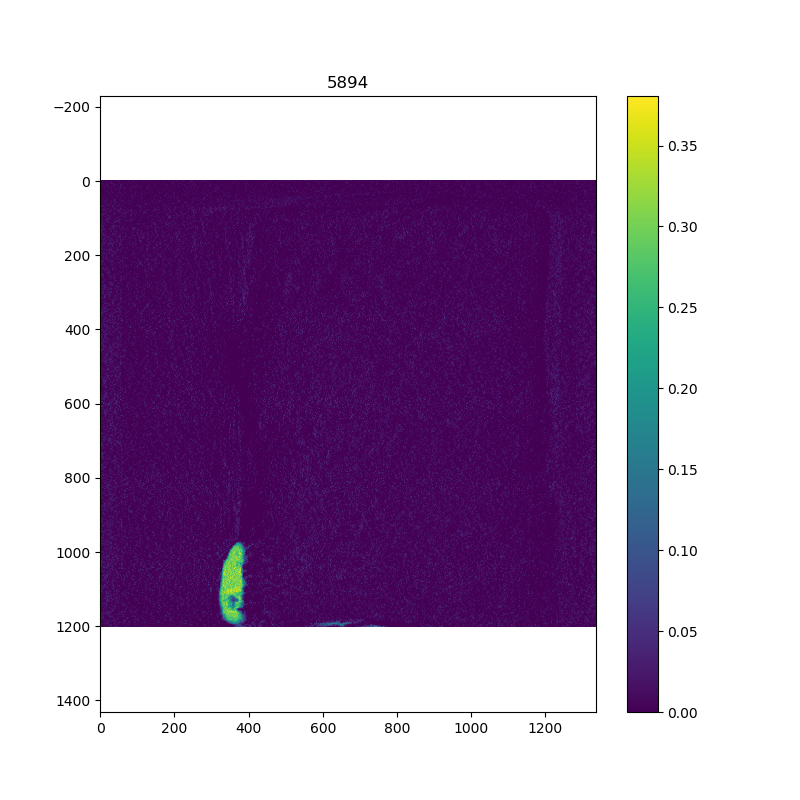

<IPython.core.display.Javascript object>


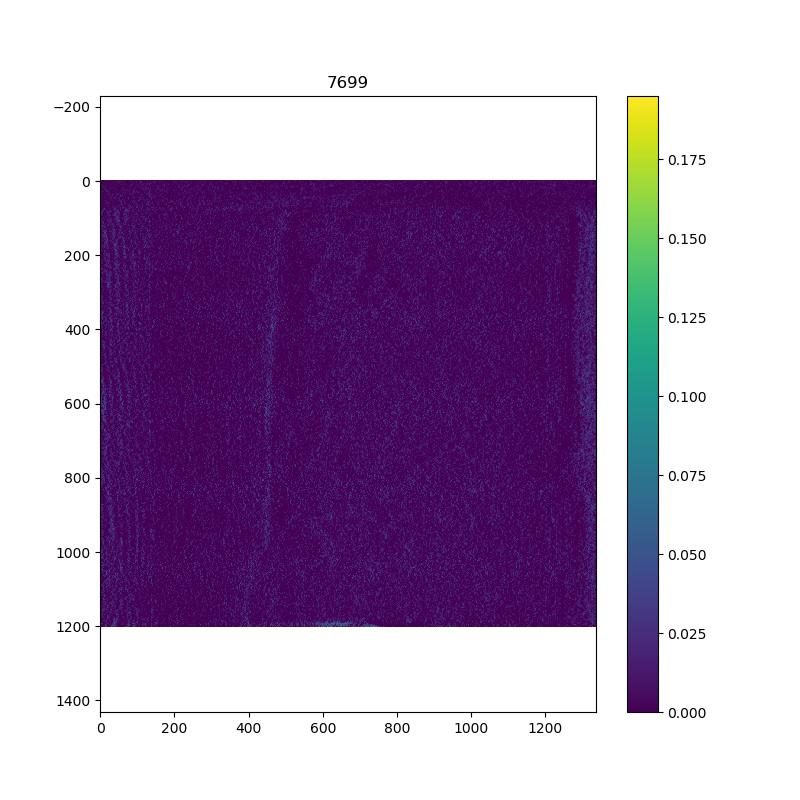

<IPython.core.display.Javascript object>


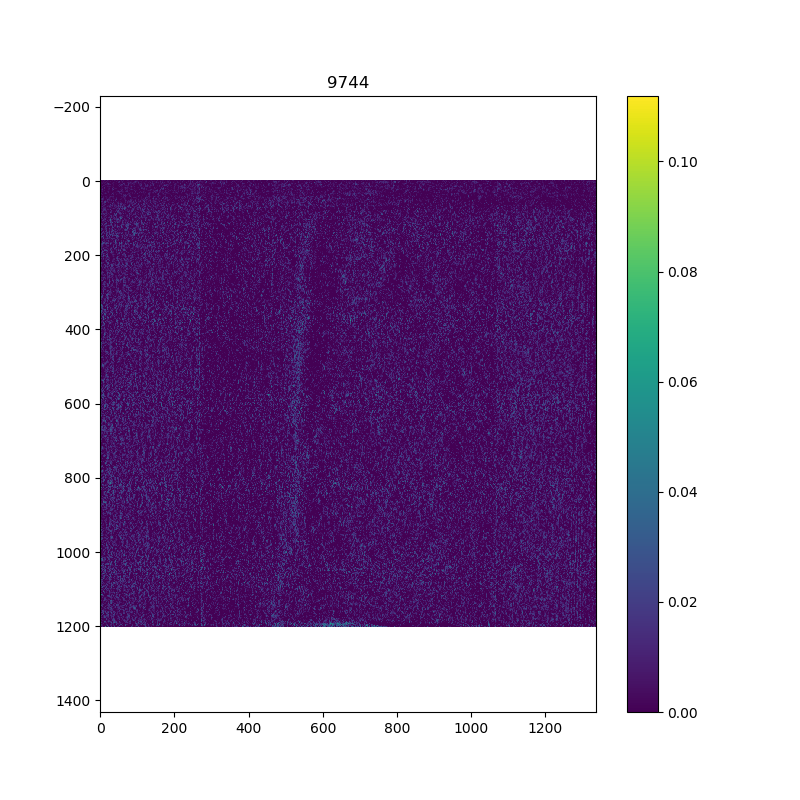

In [140]:
for i in range(10):
        plt.figure(figsize=(8,8))
        plt.imshow(rec_vol_filtered[:,i*rec_vol_filtered.shape[1]//10,:], cmap=plt.cm.viridis, vmin=0)
        plt.axis('equal')
        plt.title(i*i*rec_vol_filtered.shape[0]//10)
        plt.colorbar()
        plt.show()

<IPython.core.display.Javascript object>


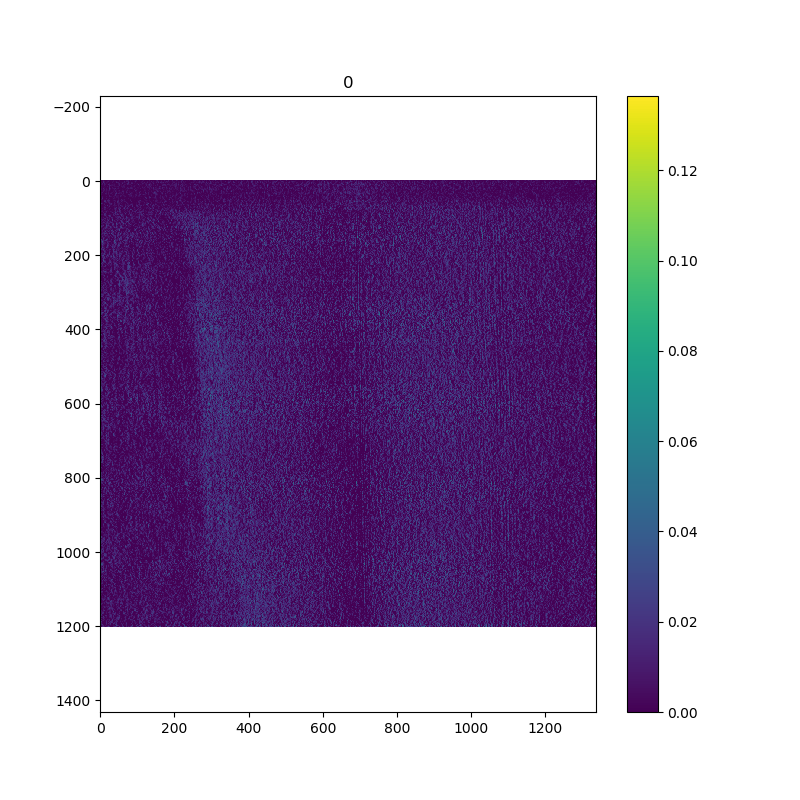

<IPython.core.display.Javascript object>


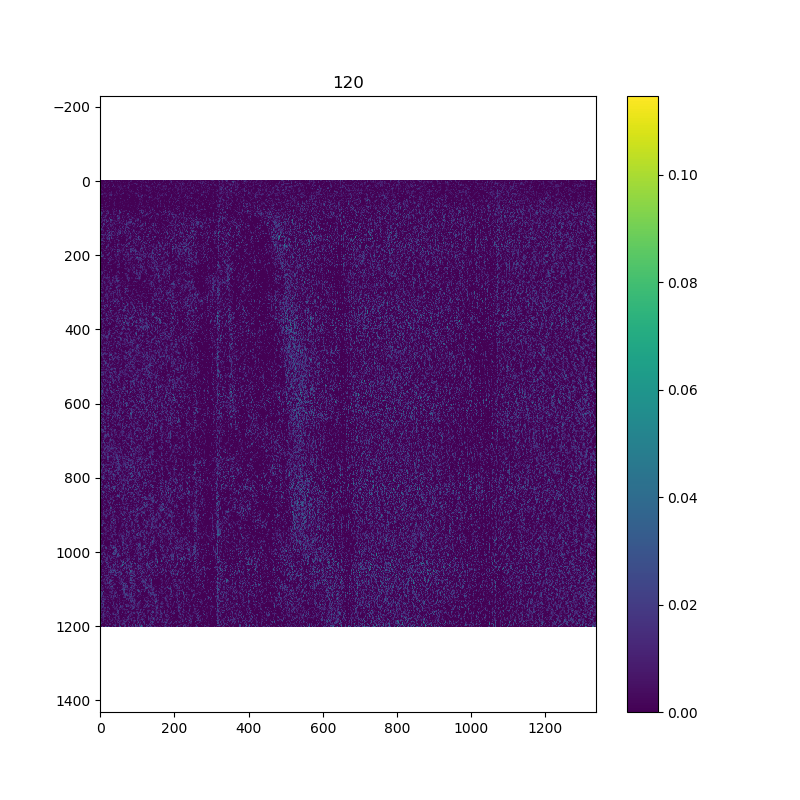

<IPython.core.display.Javascript object>


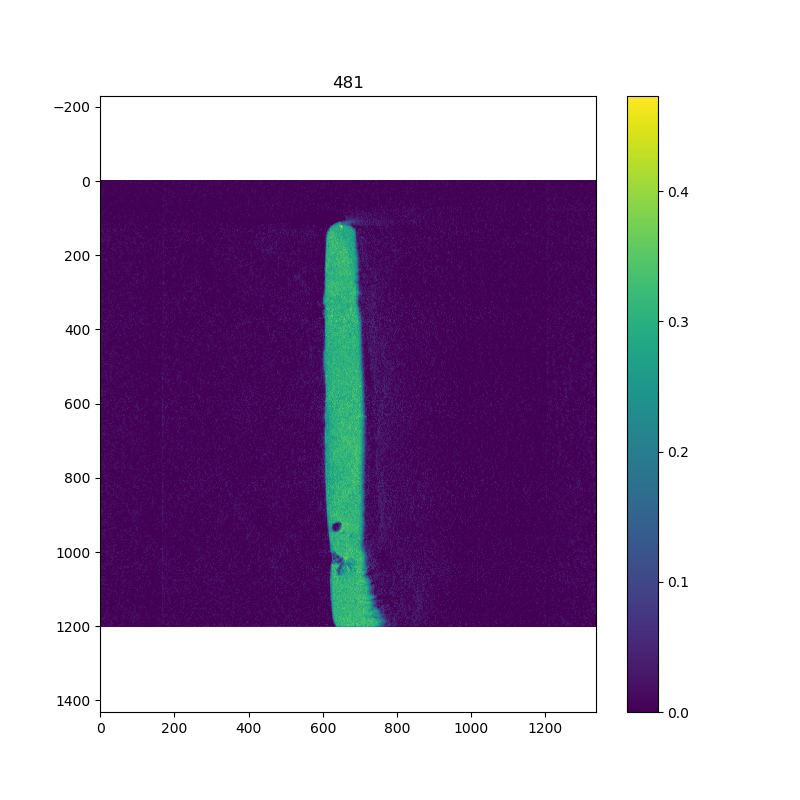

<IPython.core.display.Javascript object>


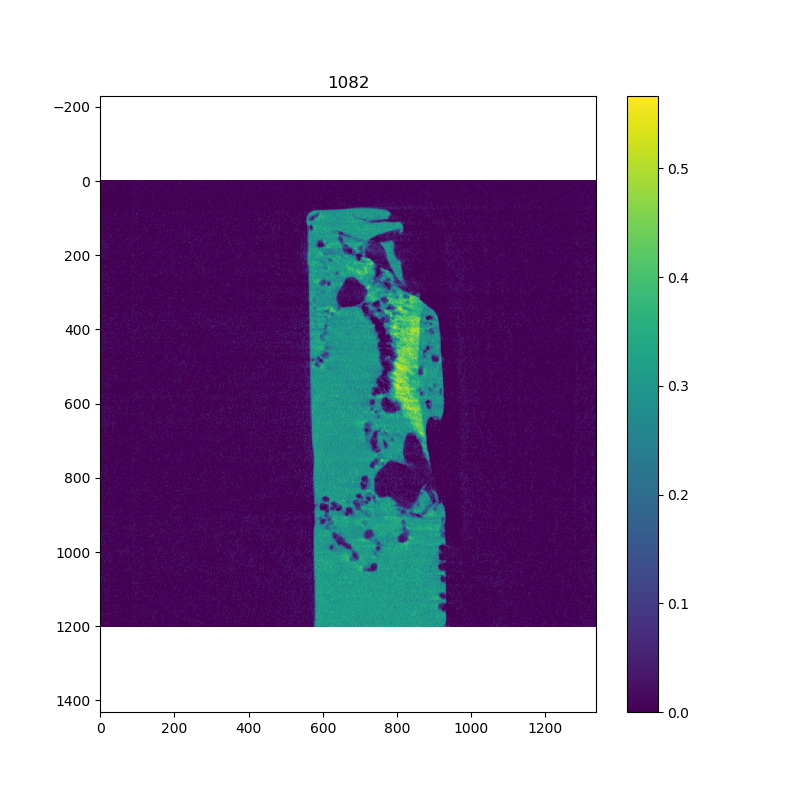

<IPython.core.display.Javascript object>


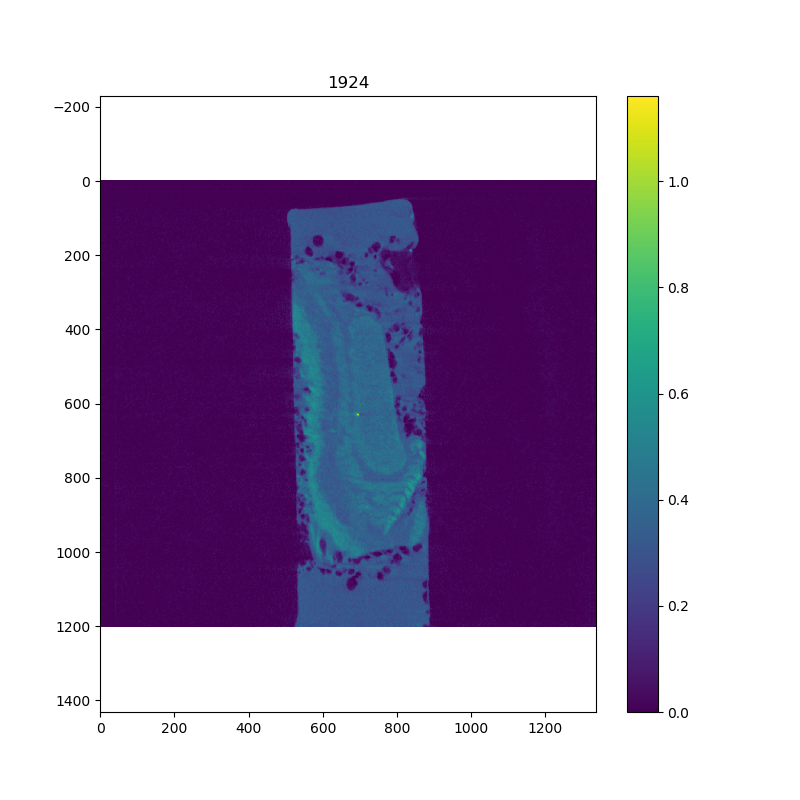

<IPython.core.display.Javascript object>


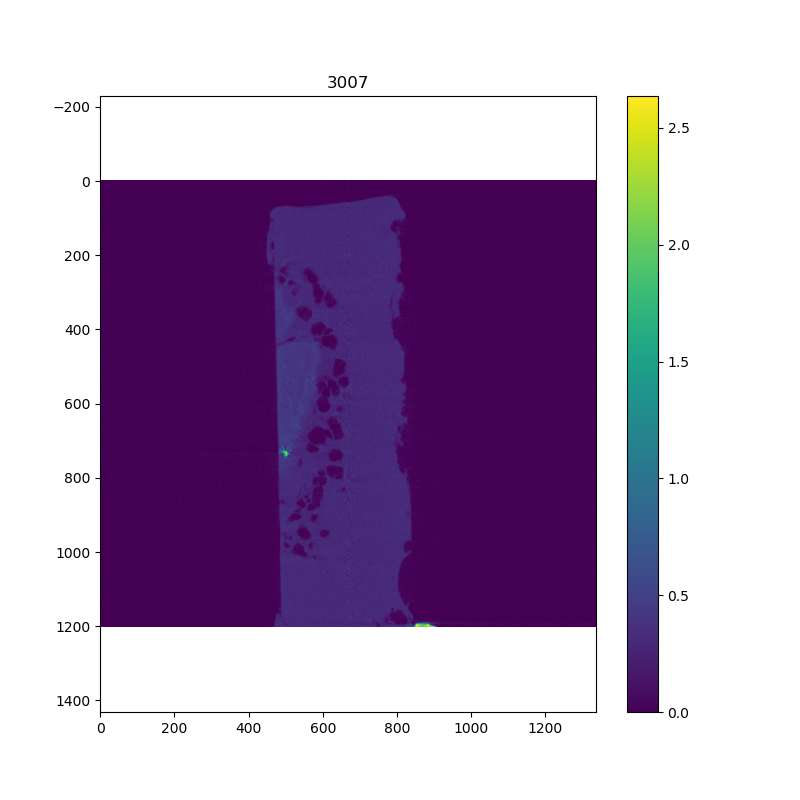

<IPython.core.display.Javascript object>


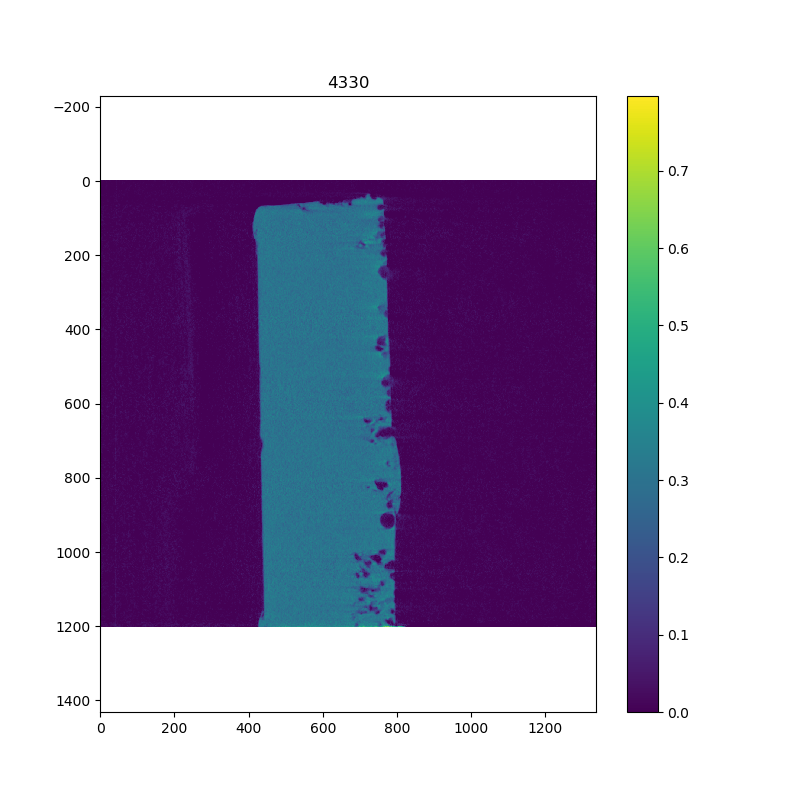

<IPython.core.display.Javascript object>


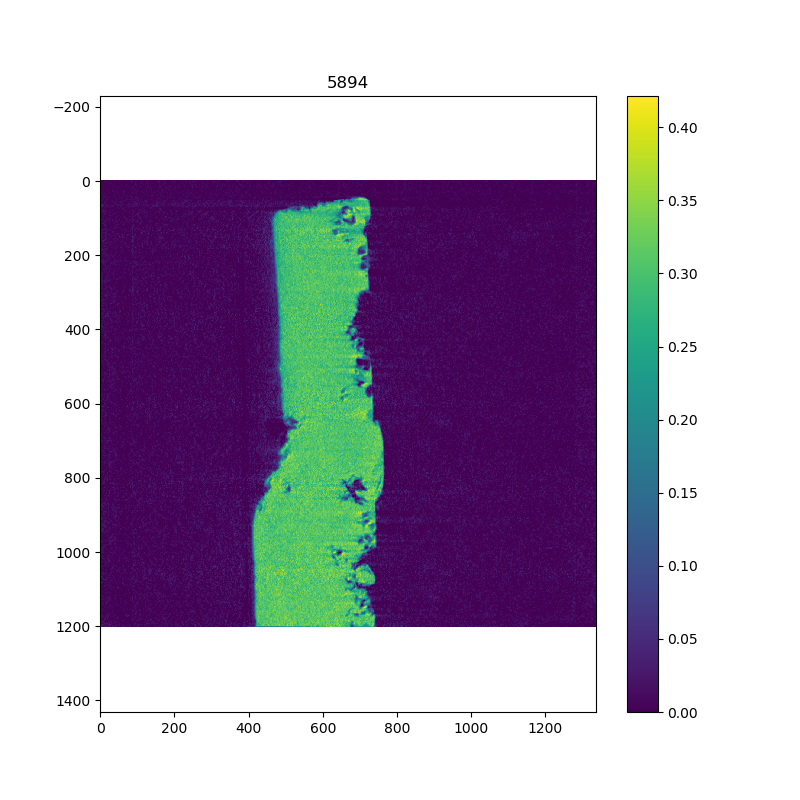

<IPython.core.display.Javascript object>


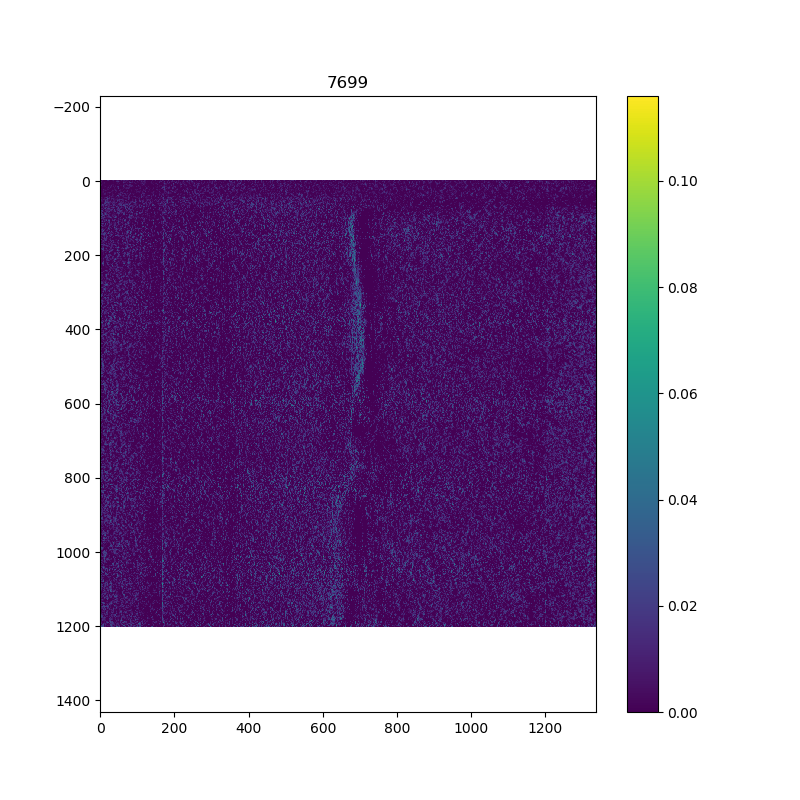

<IPython.core.display.Javascript object>


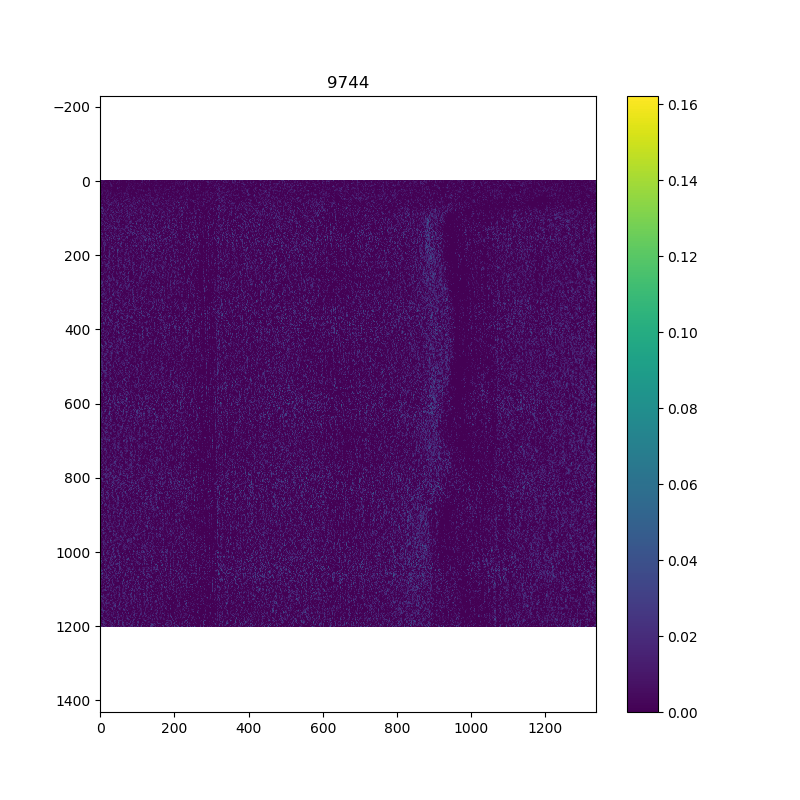

In [141]:
for i in range(10):
        plt.figure(figsize=(8,8))
        plt.imshow(rec_vol_filtered[:,:, i*rec_vol_filtered.shape[2]//10], cmap=plt.cm.viridis, vmin=0)
        plt.axis('equal')
        plt.title(i*i*rec_vol_filtered.shape[0]//10)
        plt.colorbar()
        plt.show()

estimated noise standard deviation = 0.008764791776655026


<IPython.core.display.Javascript object>


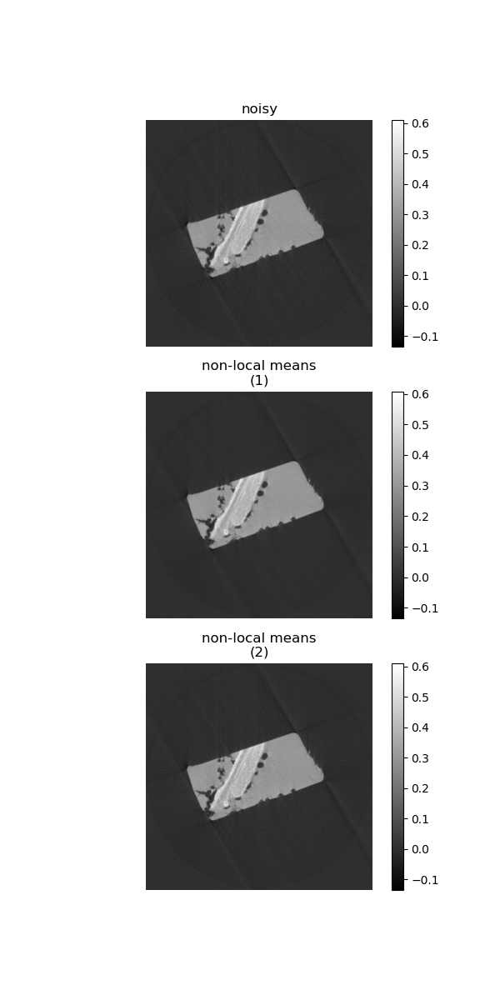

<IPython.core.display.Javascript object>


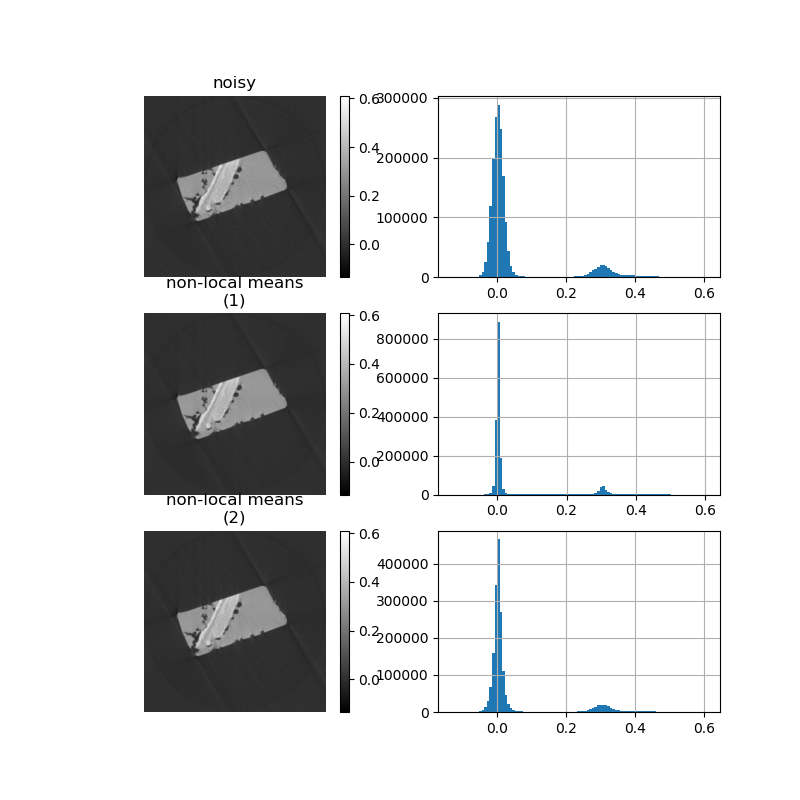

In [144]:
noisy = rec_vol_filtered[int(rec_vol_filtered.shape[0]*0.5)].astype('float64')
noisy = resize(noisy, (noisy.shape[0]//1, noisy.shape[1]//1))
# noisy = rec_vol_filtered[int(rec_vol_filtered.shape[0]*0.75)][::1,::1]
sigma_est = np.mean(estimate_sigma(noisy, multichannel=False))
print("estimated noise standard deviation = {}".format(sigma_est))

patch_kw = dict(patch_size=7,      # 5x5 patches
                patch_distance=15,  # 13x13 search area
                multichannel=False)

# 1 algorithm
denoise = denoise_nl_means(noisy, h=1.5 * sigma_est, fast_mode=True,
                           **patch_kw)



# 2 algorithm
denoise_fast = denoise_nl_means(noisy,  h=0.8 * sigma_est, fast_mode=True,
                                **patch_kw)


plt.figure(figsize=(6, 12))
plt.subplot(311)
plt.imshow(noisy, interpolation='bilinear')
plt.axis('off')
plt.colorbar()
plt.title('noisy')

plt.subplot(312)
plt.imshow(denoise, interpolation='bilinear')
plt.axis('off')
plt.colorbar()
plt.title('non-local means\n(1)')

plt.subplot(313)
plt.imshow(denoise_fast, interpolation='bilinear')
plt.axis('off')
plt.colorbar()
plt.title('non-local means\n(2)')

plt.show()

plt.figure(figsize=(8, 8))
plt.subplot(321)
plt.imshow(noisy, interpolation='bilinear')
plt.axis('off')
plt.colorbar()
plt.title('noisy')

plt.subplot(322)
plt.hist(noisy.ravel(), bins=100);
plt.grid()

plt.subplot(323)
plt.imshow(denoise, interpolation='bilinear')
plt.axis('off')
plt.colorbar()
plt.title('non-local means\n(1)')

plt.subplot(324)
plt.hist(denoise.ravel(), bins=100);
plt.grid()

plt.subplot(325)
plt.imshow(denoise_fast, interpolation='bilinear')
plt.axis('off')
plt.colorbar()
plt.title('non-local means\n(2)')

plt.subplot(326)
plt.hist(denoise_fast.ravel(), bins=100);
plt.grid()

plt.show()

In [145]:
def reshape_volume(volume, reshape):
    res = np.zeros([s//reshape for s in volume.shape], dtype='float32')
    xs,ys,zs = [s*reshape for s in res.shape]
    for x,y,z in np.ndindex(reshape, reshape, reshape):
        res += volume[x:xs:reshape, y:ys:reshape, z:zs:reshape]
    return res/reshape**3

In [146]:
def save_amira(in_array, out_path, reshape=3):
    data_path = out_path
    with open(os.path.join(data_path, 'amira.raw'), 'wb') as amira_file:
        reshaped_vol = reshape_volume(in_array, reshape)
        reshaped_vol.tofile(amira_file)
        file_shape = reshaped_vol.shape
        with open(os.path.join(data_path, 'tomo.hx'), 'w') as af:
                af.write('# Amira Script\n')
                af.write('remove -all\n')
                af.write(r'[ load -raw ${SCRIPTDIR}/amira.raw little xfastest float 1 '+
                         str(file_shape[1])+' '+str(file_shape[2])+' '+str(file_shape[0])+
                         ' 0 '+str(file_shape[1]-1)+' 0 '+str(file_shape[2]-1)+' 0 '+str(file_shape[0]-1)+
                         ' ] setLabel tomo.raw\n')


In [147]:
save_amira(rec_vol_filtered, tmp_dir, 3)

In [148]:
with h5py.File(os.path.join(tmp_dir, 'tomo_rec.h5'), 'w') as h5f:
    h5f.create_dataset('Reconstruction', data=rec_vol_filtered, chunks=True,
                            compression='lzf')

In [149]:
import ipyvolume as ipv

In [150]:
ipv.figure()
ipv.volshow(reshape_volume(rec_vol_filtered,10),
            max_shape=1024,
            extent=[[0, rec_vol_filtered.shape[2]*9e-3],
                   [0, rec_vol_filtered.shape[1]*9e-3],
                   [0, rec_vol_filtered.shape[0]*9e-3]]
           )
ipv.xlim(0, rec_vol_filtered.shape[2]*9e-3)
ipv.xlabel('mm')
ipv.ylim(0, rec_vol_filtered.shape[1]*9e-3)
ipv.ylabel('mm')
ipv.zlim(0, rec_vol_filtered.shape[0]*9e-3)
ipv.zlabel('mm')
ipv.squarelim()
ipv.show()

In [151]:
ipv.save(os.path.join(tmp_dir,'tomo.html'))

In [152]:
files_to_remove = glob(os.path.join(tmp_dir,'*.tmp'))
files_to_remove

['/diskmnt/fast/makov/robotom/907e8b4b-541e-49a1-835e-3a88863437f2/rec.tmp',
 '/diskmnt/fast/makov/robotom/907e8b4b-541e-49a1-835e-3a88863437f2/uniq_angles.tmp',
 '/diskmnt/fast/makov/robotom/907e8b4b-541e-49a1-835e-3a88863437f2/sinogram_fixed.tmp']

In [153]:
for fr in files_to_remove:
    try:
        os.remove(os.path.join(tmp_dir,fr))
    except:
        pass
    try:
        os.remove(os.path.join(tmp_dir,fr+'.size'))
    except:
        pass


In [159]:
tomotools.mkdir_p(os.path.join(storage_dir, experiment_id))

In [160]:
!cp 'tomo.ini'  {os.path.join(storage_dir, experiment_id)}

cp: cannot stat 'tomo.ini': No such file or directory


In [161]:
!cp -r {tmp_dir} {storage_dir}

In [162]:
!rm -rf {tmp_dir}

In [163]:
!mv {os.path.join(data_dir, experiment_id+'.h5')} {storage_dir}

In [169]:
!ls -lha {storage_dir+'/'+experiment_id}

total 17G
drwxr-xr-x   2 makov makov 4,0K апр 26 12:05 .
drwxrwxr-x 106 makov makov  20K мая  6 15:56 ..
-rw-r--r--   1 makov makov 8,1G мая  6 15:53 amira.raw
-rw-r--r--   1 makov makov  17M апр 26 12:05 reconstructor-v.1.6.html
-rw-rw-r--   1 makov makov  16M апр 26 12:05 reconstructor-v.1.6.ipynb
-rw-r--r--   1 makov makov  12M мая  6 15:55 tomo.html
-rw-r--r--   1 makov makov  142 мая  6 15:54 tomo.hx
-rw-r--r--   1 makov makov  414 апр 26 12:05 tomo.ini
-rw-r--r--   1 makov makov 8,1G мая  6 15:54 tomo_rec.h5
